In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
file_path="/home/popoy/UI-PRMD/data/Movements/Vicon/Angles/m01_s01_angles.txt"
data2 = pd.read_csv(file_path, header=None, sep=r'\s+')
data2.describe()


,0,1,2,3,4,5,6,7,8,9,...,107,108,109,110,111,112,113,114,115,116
count,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,...,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000,2300.000000
mean,1.921151,8.977882,-0.329979,-8.964989,1.888011,0.220345,-8.964989,-1.888011,-0.220345,-3.382856,...,-75.300311,-75.110885,116.422791,76.121565,-42.619933,146.290186,-5.935481,16.027865,145.824273,-10.586608
std,1.339039,7.873227,1.737865,7.909565,1.283937,1.820270,7.909565,1.283937,1.820270,12.199893,...,26.360168,24.784444,8.651924,27.089235,10.497701,26.820973,13.934954,7.937252,31.296323,8.553237
min,-1.985980,-23.634200,-6.385620,-23.714200,-1.930090,-3.803420,-23.714200,-5.709200,-7.346090,-26.763800,...,-201.014000,-97.506700,75.815500,50.843600,-97.614700,120.687000,-22.441600,-4.728040,120.647000,-21.062700
25%,1.061793,5.560807,-1.415425,-12.942050,1.028612,-1.000172,-12.942050,-2.856805,-1.266485,-14.105400,...,-80.715325,-84.770125,113.249500,60.224175,-45.279325,134.694250,-13.204775,11.390400,132.278250,-14.951850
50%,1.685205,9.664160,-0.349077,-9.666150,1.650810,0.189069,-9.666150,-1.650810,-0.189069,-3.857260,...,-70.442650,-78.234500,117.143500,71.672850,-43.181500,141.082000,-8.715675,16.630850,139.424500,-11.935200
75%,2.775373,12.926650,0.876948,-5.566718,2.856805,1.266485,-5.566718,-1.028612,1.000172,7.572178,...,-61.137200,-75.612500,121.823750,83.639775,-38.531050,149.110250,-4.102285,20.953375,147.647000,-8.931492
max,6.747290,23.721200,3.721980,23.985600,5.709200,7.346090,23.985600,1.930090,3.803420,19.864600,...,-53.714000,52.812800,129.468000,198.191000,-18.605400,278.808000,66.833700,43.581200,297.166000,43.559600


In [ ]:
data2=pd.read_csv("/home/popoy/UI-PRMD/data/Segmented Movements/Vicon/Positions/m01_s01_e01_positions.txt")
data2.describe()

import pandas as pd
import numpy as np
import plotly.graph_objects as go

# We'll use the filename you provided
file_path = '/home/popoy/UI-PRMD/data/Segmented Movements/Vicon/Positions/m01_s01_e01_positions.txt'

try:
    # Load the position data, assuming the first row is the header as in your notebook
    data = pd.read_csv(file_path)
    
    # Check if data is not empty
    if not data.empty:
        # Select a frame to plot (e.g., the middle frame)
        frame_to_plot = data.iloc[len(data) // 2]
        
        # Reshape the 117 columns into 39 (X, Y, Z) points
        # This assumes the data is in X,Y,Z,X,Y,Z... format
        try:
            points = frame_to_plot.values.reshape(-1, 3)
            x_coords = points[:, 0]
            y_coords = points[:, 1]
            z_coords = points[:, 2]
        except ValueError:
            # Fallback if reshape fails (e.g., if data isn't 39*3)
            # This is a common structure: X1..X39, Y1..Y39, Z1..Z39
            num_points = len(frame_to_plot) // 3
            x_coords = frame_to_plot.values[0:num_points]
            y_coords = frame_to_plot.values[num_points:2*num_points]
            z_coords = frame_to_plot.values[2*num_points:3*num_points]

        # Create the 3D scatter plot
        fig = go.Figure(data=[go.Scatter3d(
            x=x_coords,
            y=y_coords,
            z=z_coords,
            mode='markers',
            marker=dict(
                size=5,
                color=z_coords, # Color points by their Z-height
                colorscale='Viridis',
                opacity=0.8
            )
        )])

        fig.update_layout(
            title=f'3D Pose Snapshot (Frame {len(data) // 2}) from {file_path}',
            scene=dict(
                xaxis_title='X Coordinate',
                yaxis_title='Y Coordinate',
                zaxis_title='Z Coordinate',
                aspectmode='data' # This makes the axes scale 1:1:1
            ),
            margin=dict(l=0, r=0, b=0, t=40)
        )

        fig.show()
    else:
        print(f"The file '{file_path}' was loaded but appears to be empty.")

except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please make sure it has been uploaded.")
except Exception as e:
    print(f"An error occurred: {e}")

In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.io as pio

# Set the default renderer to 'notebook' to ensure updates
pio.renderers.default = "notebook"

# --- PERFORMANCE OPTIMIZATION ---
# We will only plot every Nth frame.
# A smaller number is smoother but slower.
# A larger number is faster but choppier.
# 5 is a good balance.
frame_step = 5

# The position data file you uploaded
file_path = '/home/popoy/UI-PRMD/data/Movements/Vicon/Positions/m01_s01_positions.txt'

try:
    # Load the position data
    data = pd.read_csv(file_path, header=None, delim_whitespace=True)
    
    if data.empty:
        print(f"The file '{file_path}' was loaded but appears to be empty.")
    else:
        print(f"File '{file_path}' loaded successfully. Shape: {data.shape}")
        
        # --- 1. Prepare Data for Animation (Corrected Shape Logic) ---
        
        num_frames = data.shape[0]
        num_columns = data.shape[1]
        
        if num_columns % 3 != 0:
            raise ValueError(f"Number of columns ({num_columns}) is not divisible by 3. Cannot reshape to (X,Y,Z).")
            
        num_points = num_columns // 3
        print(f"Assuming {num_points} points per frame.")

        # Get all data as a NumPy array
        all_data_np = data.values
        
        # Reshape the data to (num_frames, num_points, 3)
        try:
            all_coords = all_data_np.reshape(num_frames, num_points, 3)
            print(f"Data successfully reshaped to {all_coords.shape} (Frames, Points, Dims).")
        except ValueError as e:
            print(f"Error: Could not reshape data to (frames, points, 3). This implies the X,Y,Z data is not interleaved.")
            raise e

        # Extract all X, Y, and Z coordinates for all frames
        all_x = all_coords[:, :, 0]
        all_y = all_coords[:, :, 1]
        all_z = all_coords[:, :, 2]
        
        print("Successfully extracted X, Y, Z coordinate arrays.")

        # --- 2. Create the Figure and Frames (Optimized) ---

        # Calculate global min/max for all axes to keep the scene stable
        x_range = [np.nanmin(all_x), np.nanmax(all_x)]
        y_range = [np.nanmin(all_y), np.nanmax(all_y)]
        z_range = [np.nanmin(all_z), np.nanmax(all_z)]
        print("Calculated axis ranges for stable animation.")

        # Create the list of frame indices we will actually animate
        frame_indices_to_plot = list(range(0, num_frames, frame_step))
        print(f"Original frames: {num_frames}. Animating {len(frame_indices_to_plot)} frames (every {frame_step}th frame).")

        # Create the animation frames
        animation_frames = []
        for k in frame_indices_to_plot:
            frame_data = go.Scatter3d(
                x=all_x[k], 
                y=all_y[k], 
                z=all_z[k],
                mode='markers',
                marker=dict(
                    size=5, 
                    color=all_z[k], # Color by height
                    colorscale='Viridis',
                    cmin=z_range[0], # Keep color range consistent
                    cmax=z_range[1]
                )
            )
            # Use the original frame index 'k' as the name
            animation_frames.append(go.Frame(data=[frame_data], name=f'Frame {k}'))
        
        print(f"Created {len(animation_frames)} animation frames.")

        # Create the initial figure with the first frame (Frame 0)
        fig = go.Figure(
            data=animation_frames[0].data, # Start with Frame 0
            frames=animation_frames         # Add all other frames
        )
        print("Plotly Figure object created.")

        # --- 3. Add Animation Controls (Optimized) ---

        def create_slider_steps(indices_list):
            steps = []
            for i, frame_index in enumerate(indices_list):
                step = dict(
                    method='animate',
                    args=[
                        [f'Frame {frame_index}'], # Animate to the frame with this name
                        dict(
                            mode='immediate',
                            frame=dict(duration=30, redraw=True), # Force redraw
                            transition=dict(duration=0)
                        )
                    ],
                    label=str(frame_index) # Label the slider with the original frame index
                )
                steps.append(step)
            return steps

        fig.update_layout(
            title=f'3D Position Animation (Optimized: 1 in {frame_step} frames)',
            scene=dict(
                xaxis_title='X Coordinate',
                yaxis_title='Y Coordinate',
                zaxis_title='Z Coordinate',
                aspectmode='data', # Ensures 1:1:1 aspect ratio
                xaxis_range=x_range,
                yaxis_range=y_range,
                zaxis_range=z_range
            ),
            updatemenus=[dict(
                type='buttons',
                showactive=False,
                buttons=[
                    dict(label='Play',
                         method='animate',
                         args=[None, dict(frame=dict(duration=30, redraw=True),
                                          fromcurrent=True,
                                          transition=dict(duration=0))]),
                    dict(label='Pause',
                         method='animate',
                         args=[[None], dict(mode='immediate',
                                            frame=dict(duration=0, redraw=True),
                                            transition=dict(duration=0))])
                ]
            )],
            # Add the animation slider, using our custom steps function
            sliders=[dict(
                active=0,
                steps=create_slider_steps(frame_indices_to_plot),
                pad=dict(t=0, b=10)
            )]
        )
        
        print("Figure layout updated with controls.")
        
        # This will render the animation inline in your notebook
        fig.show()


except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found.")
except Exception as e:
    print(f"An error occurred while processing the data: {e}")

/tmp/ipykernel_7423/3698685020.py:21: FutureWarning:

The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead



File '/home/popoy/projects/proj_1/webapp/Physio/public/UI-PRMD/data/Movements/Vicon/Positions/m01_s01_positions.txt' loaded successfully. Shape: (2300, 117)
Assuming 39 points per frame.
Data successfully reshaped to (2300, 39, 3) (Frames, Points, Dims).
Successfully extracted X, Y, Z coordinate arrays.
Calculated axis ranges for stable animation.
Original frames: 2300. Animating 460 frames (every 5th frame).
Created 460 animation frames.
Plotly Figure object created.
Figure layout updated with controls.


In [ ]:
data=pd.read_csv("/home/popoy/UI-PRMD/data/Segmented Movements/Vicon/Angles/m01_s01_e01_angles.txt")
data.describe()

,2.403870,13.460700,0.681939,-13.482100,2.301950,-0.957318,-13.482100.1,-2.301950,0.957318,10.956800,...,-58.922800,-95.743600,109.969000,61.012600,-22.479000,133.146000,-21.333500,0.007713,132.821000,1.869640
count,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,...,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000
mean,1.784312,10.907201,1.000096,-10.927622,1.675815,-1.171125,-10.927622,-1.675815,1.171125,-5.158709,...,-70.378671,-90.222391,114.610042,73.464068,-27.796942,139.179426,-17.211782,2.694098,137.355426,-1.678231
std,0.856864,2.814841,0.720486,2.820844,0.822267,0.750103,2.820844,0.822267,0.750103,10.008302,...,9.805420,3.149006,2.985662,12.041766,8.102506,5.774563,1.597638,5.869538,4.976161,3.086067
min,0.664609,2.147080,-0.552779,-13.412800,0.534138,-2.194880,-13.412800,-3.487740,-0.394833,-18.020200,...,-82.464200,-97.506700,107.628000,51.457800,-40.551100,128.532000,-21.079300,-3.625940,128.007000,-6.407820
25%,1.168582,10.835050,0.604009,-12.533325,1.077292,-1.861260,-12.533325,-2.112122,0.696251,-15.233275,...,-80.611150,-91.711075,113.093000,63.598975,-38.172150,134.987750,-18.323475,-1.898790,132.715000,-4.661447
50%,1.603150,11.942950,1.052910,-11.984700,1.553060,-1.160200,-11.984700,-1.553060,1.160200,-6.340575,...,-71.282800,-88.975750,115.201000,74.640150,-24.923850,138.718000,-17.288000,-0.972949,138.365000,-1.326325
75%,2.225383,12.508950,1.642670,-10.844275,2.112122,-0.696251,-10.844275,-1.077292,1.861260,6.188847,...,-61.313200,-88.469550,116.375750,85.283175,-20.981400,145.604750,-16.004775,10.578325,142.356750,1.575705
max,3.716330,13.391700,2.010170,-2.151150,3.487740,0.394833,-2.151150,-0.534138,2.194880,10.338700,...,-54.569000,-86.183700,119.554000,89.154300,-18.605400,146.359000,-14.435700,12.020400,143.503000,2.611550


✅ Successfully loaded data with shape: (2300, 117)
   (2300 time frames, 117 angle measurements per frame)


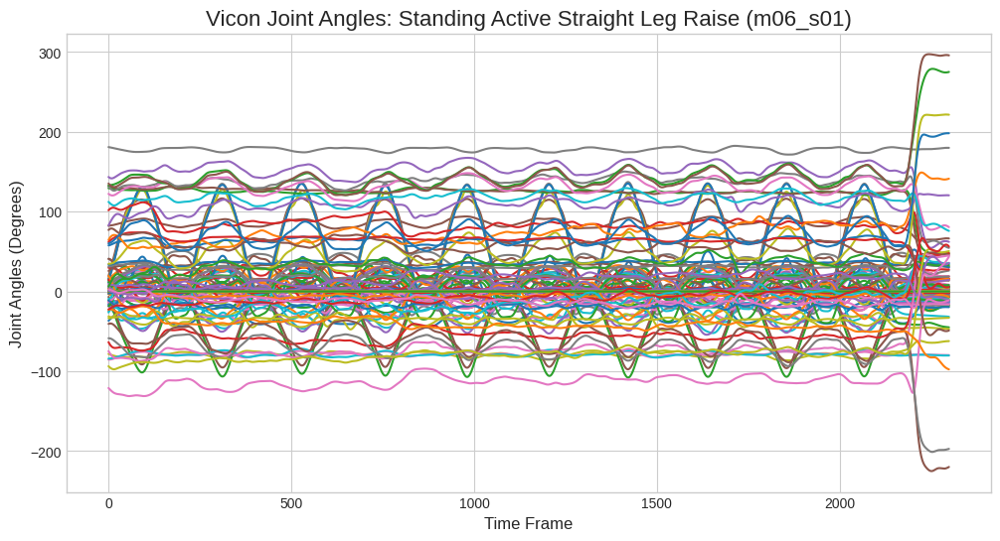

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

file_path = '/home/popoy/UI-PRMD/data/Movements/Vicon/Angles/m01_s01_angles.txt'

try:
    
    joint_angles = np.loadtxt(file_path)
    
    print(f"✅ Successfully loaded data with shape: {joint_angles.shape}")
    print(f"   ({joint_angles.shape[0]} time frames, {joint_angles.shape[1]} angle measurements per frame)")

    plt.style.use('seaborn-v0_8-whitegrid')
    plt.figure(figsize=(12, 6))
    plt.plot(joint_angles)
    plt.title('Vicon Joint Angles: Standing Active Straight Leg Raise (m06_s01)', fontsize=16)
    plt.xlabel('Time Frame', fontsize=12)
    plt.ylabel('Joint Angles (Degrees)', fontsize=12)
    
    plt.show()

except FileNotFoundError:
    print(f"❌ Error: The file was not found at the specified path:")
    print(f"   '{file_path}'")
    print("   Please make sure the 'file_path' variable is correct.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

In [ ]:
import numpy as np
import os
from pathlib import Path
import re
from sklearn.preprocessing import StandardScaler
import joblib

# This mapping defines which angles we want to extract for our ML model.
# The keys are descriptive names, and the values are the 0-based column indices
# in the 117-column Vicon angle files.
ANGLE_MAPPING = {
    # Head & Torso (4 joints)
    "Head_Y": 0, "Head_X": 1, "Head_Z": 2,
    "Neck_Y": 9, "Neck_X": 10, "Neck_Z": 11,  # Using 'Left neck' from Vicon
    "Torso_Y": 21, "Torso_X": 22, "Torso_Z": 23,
    "Pelvis_Y": 30, "Pelvis_X": 31, "Pelvis_Z": 32,
    
    # Left Leg (3 joints)
    "L_Hip_Y": 39, "L_Hip_X": 40, "L_Hip_Z": 41,
    "L_Knee_Y": 51, "L_Knee_X": 52, "L_Knee_Z": 53,
    "L_Ankle_Y": 63, "L_Ankle_X": 64, "L_Ankle_Z": 65,

    # Right Leg (3 joints)
    "R_Hip_Y": 42, "R_Hip_X": 43, "R_Hip_Z": 44,
    "R_Knee_Y": 54, "R_Knee_X": 55, "R_Knee_Z": 56,
    "R_Ankle_Y": 66, "R_Ankle_X": 67, "R_Ankle_Z": 68,
    
    # Left Arm (3 joints)
    "L_Shoulder_Y": 81, "L_Shoulder_X": 82, "L_Shoulder_Z": 83,
    "L_Elbow_Y": 87, "L_Elbow_X": 88, "L_Elbow_Z": 89,
    "L_Wrist_Y": 99, "L_Wrist_X": 100, "L_Wrist_Z": 101,

    # Right Arm (3 joints)
    "R_Shoulder_Y": 84, "R_Shoulder_X": 85, "R_Shoulder_Z": 86,
    "R_Elbow_Y": 90, "R_Elbow_X": 91, "R_Elbow_Z": 92,
    "R_Wrist_Y": 102, "R_Wrist_X": 103, "R_Wrist_Z": 104,
}

def load_and_extract_angles(input_path):
    """
    Loads a single episode file, extracts the 48 key angles, and returns them.
    """
    try:
        vicon_angles_flat = np.loadtxt(input_path, delimiter=",")
        if vicon_angles_flat.ndim == 1:
            vicon_angles_flat = np.expand_dims(vicon_angles_flat, axis=0)
        if vicon_angles_flat.shape[0] == 0:
            return None
        angle_indices = list(ANGLE_MAPPING.values())
        extracted_angles = vicon_angles_flat[:, angle_indices]
        return extracted_angles
    except Exception:
        return None

def concatenate_episodes(episodes_list):
    """
    Stitches all episodes into a single continuous time series array (X)
    and creates a parallel array of frame-by-frame labels (y).
    """
    print("\n--- Step 1: Concatenating all episodes into a single sequence ---")
    
    # Concatenate all data arrays vertically
    X_continuous = np.vstack([ep["data"] for ep in episodes_list])
    
    # Create a corresponding label for every single frame
    y_continuous_list = []
    for ep in episodes_list:
        # The label is the movement number, repeated for the duration of the episode
        y_continuous_list.extend([ep["movement"]] * ep["data"].shape[0])
    
    y_continuous = np.array(y_continuous_list, dtype=np.int32)
    
    print(f"✅ Created continuous data stream.")
    return X_continuous, y_continuous

def create_sliding_windows(X_continuous, y_continuous, window_size=60, stride=10):
    """
    Creates a dataset of fixed-size sliding windows from the continuous data stream.
    """
    print(f"\n--- Step 3: Creating sliding windows ---")
    print(f"Window size: {window_size}, Stride: {stride}")

    X_windows, y_windows = [], []
    
    for i in range(0, len(X_continuous) - window_size, stride):
        # The data window
        window = X_continuous[i : i + window_size]
        X_windows.append(window)
        
        # The label for the window is the label of the frame at the end of the window
        label = y_continuous[i + window_size - 1]
        y_windows.append(label)
    
    print(f"✅ Created {len(X_windows)} sliding window samples.")
    return np.array(X_windows, dtype=np.float32), np.array(y_windows, dtype=np.int32)

def main():
    """
    Scans for and processes all segmented episode files.
    """
    root_data_path = Path('/home/popoy/UI-PRMD/data')
    print(f"Scanning for segmented Vicon ANGLE files in: {root_data_path}")
    
    correct_files = list(root_data_path.rglob("Segmented Movements/Vicon/Angles/*.txt"))
    
    if not correct_files:
        print("❌ No 'correct' episode files found.")
        return []

    print(f"\nFound {len(correct_files)} 'correct' episode files to process.")
    
    correct_episodes = []
    for filepath in correct_files:
        angle_data = load_and_extract_angles(filepath)
        if angle_data is not None:
            match = re.search(r"m(\d+)_s(\d+)_e(\d+)", filepath.name)
            if match:
                m_num, s_num, e_num = map(int, match.groups())
                correct_episodes.append(
                    {
                        "movement": m_num,
                        "data": angle_data,
                    }
                )

    print(f"\n🎉 Processing complete! Loaded {len(correct_episodes)} correct episodes.")
    return correct_episodes

if __name__ == "__main__":
    # --- Cell 1: Data Loading and Preparation ---
    correct_episodes = main()

    if correct_episodes:
        # --- Step 1: Create the long, continuous data stream ---
        X_continuous, y_continuous = concatenate_episodes(correct_episodes)

        # --- Step 2: Normalize the data ---
        print("\n--- Step 2: Normalizing data with StandardScaler ---")
        scaler = StandardScaler()
        X_normalized = scaler.fit_transform(X_continuous)
        
        # Save the scaler to a file for later use in production
        scaler_path = 'angle_scaler.joblib'
        joblib.dump(scaler, scaler_path)
        print(f"✅ Data normalized. Scaler saved to '{scaler_path}'")

        # --- Step 3: Create the final windowed dataset for training ---
        X_train, y_train = create_sliding_windows(
            X_normalized, y_continuous, window_size=60, stride=20
        )

        print("\n--- Final ML Data Shapes ---")
        print(f"  Shape of the normalized continuous sequence:")
        print(f"    X_normalized shape: {X_normalized.shape}")

        print(f"\n  Shape of the final training data (after sliding window):")
        print(f"    X_train shape: {X_train.shape}")
        print(f"    y_train shape: {y_train.shape}")



Scanning for segmented Vicon ANGLE files in: /home/popoy/projects/proj_1/webapp/Physio/public/UI-PRMD/data

Found 990 'correct' episode files to process.

🎉 Processing complete! Loaded 990 correct episodes.

--- Step 1: Concatenating all episodes into a single sequence ---
✅ Created continuous data stream.

--- Step 2: Normalizing data with StandardScaler ---
✅ Data normalized. Scaler saved to 'angle_scaler.joblib'

--- Step 3: Creating sliding windows ---
Window size: 60, Stride: 20
✅ Created 12124 sliding window samples.

--- Final ML Data Shapes ---
  Shape of the normalized continuous sequence:
    X_normalized shape: (242535, 48)

  Shape of the final training data (after sliding window):
    X_train shape: (12124, 60, 48)
    y_train shape: (12124,)


In [22]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

# This ANGLE_MAPPING must be available from the previous cell.
ANGLE_MAPPING = {
    'Head_Y': 0, 'Head_X': 1, 'Head_Z': 2,'Neck_Y': 9, 'Neck_X': 10, 'Neck_Z': 11,
    'Torso_Y': 21, 'Torso_X': 22, 'Torso_Z': 23,'Pelvis_Y': 30, 'Pelvis_X': 31, 'Pelvis_Z': 32,
    'L_Hip_Y': 39, 'L_Hip_X': 40, 'L_Hip_Z': 41,'L_Knee_Y': 51, 'L_Knee_X': 52, 'L_Knee_Z': 53,
    'L_Ankle_Y': 63, 'L_Ankle_X': 64, 'L_Ankle_Z': 65,'R_Hip_Y': 42, 'R_Hip_X': 43, 'R_Hip_Z': 44,
    'R_Knee_Y': 54, 'R_Knee_X': 55, 'R_Knee_Z': 56,'R_Ankle_Y': 66, 'R_Ankle_X': 67, 'R_Ankle_Z': 68,
    'L_Shoulder_Y': 81, 'L_Shoulder_X': 82, 'L_Shoulder_Z': 83,'L_Elbow_Y': 87, 'L_Elbow_X': 88, 'L_Elbow_Z': 89,
    'L_Wrist_Y': 99, 'L_Wrist_X': 100, 'L_Wrist_Z': 101,'R_Shoulder_Y': 84, 'R_Shoulder_X': 85, 'R_Shoulder_Z': 86,
    'R_Elbow_Y': 90, 'R_Elbow_X': 91, 'R_Elbow_Z': 92,'R_Wrist_Y': 102, 'R_Wrist_X': 103, 'R_Wrist_Z': 104,
}

# Define groups for subplots
PLOT_GROUPS = {
    'Head & Torso': ['Head_Y', 'Head_X', 'Head_Z', 'Neck_Y', 'Neck_X', 'Neck_Z', 'Torso_Y', 'Torso_X', 'Torso_Z', 'Pelvis_Y', 'Pelvis_X', 'Pelvis_Z'],
    'Left Leg': ['L_Hip_Y', 'L_Hip_X', 'L_Hip_Z', 'L_Knee_Y', 'L_Knee_X', 'L_Knee_Z', 'L_Ankle_Y', 'L_Ankle_X', 'L_Ankle_Z'],
    'Right Leg': ['R_Hip_Y', 'R_Hip_X', 'R_Hip_Z', 'R_Knee_Y', 'R_Knee_X', 'R_Knee_Z', 'R_Ankle_Y', 'R_Ankle_X', 'R_Ankle_Z'],
    'Left Arm': ['L_Shoulder_Y', 'L_Shoulder_X', 'L_Shoulder_Z', 'L_Elbow_Y', 'L_Elbow_X', 'L_Elbow_Z', 'L_Wrist_Y', 'L_Wrist_X', 'L_Wrist_Z'],
    'Right Arm': ['R_Shoulder_Y', 'R_Shoulder_X', 'R_Shoulder_Z', 'R_Elbow_Y', 'R_Elbow_X', 'R_Elbow_Z', 'R_Wrist_Y', 'R_Wrist_X', 'R_Wrist_Z'],
}

def plot_continuous_interactive(x_data, y_data, frame_slice=None):
    """
    Creates a large, interactive Plotly graph for a slice of the continuous data stream
    with a slider and play button to animate a frame marker.
    """
    if frame_slice:
        x_data = x_data[frame_slice]
        y_data = y_data[frame_slice]

    if x_data.shape[0] == 0:
        print("❌ Data is empty for the selected slice, cannot plot.")
        return

    num_groups = len(PLOT_GROUPS)
    fig = make_subplots(
        rows=num_groups, cols=1,
        shared_xaxes=True,
        subplot_titles=list(PLOT_GROUPS.keys())
    )

    angle_names = list(ANGLE_MAPPING.keys())

    # Add all 48 traces to the subplots
    for i, (group_name, group_angles) in enumerate(PLOT_GROUPS.items()):
        for angle_name in group_angles:
            if angle_name in angle_names:
                angle_idx = angle_names.index(angle_name)
                fig.add_trace(go.Scatter(
                    y=x_data[:, angle_idx],
                    name=angle_name,
                    mode='lines',
                    legendgroup=group_name
                ), row=i + 1, col=1)

    # --- Create the animation slider and play button ---
    total_frames = x_data.shape[0]
    
    # Define the vertical line shape that will be moved by the slider
    fig.update_layout(
        shapes=[dict(
            type='line',
            yref='paper',
            y0=0, y1=1,
            xref='x',
            x0=0, x1=0,
            line=dict(color='black', width=2)
        )]
    )

    

    # Update the layout with the slider and play/pause buttons
    title = f"Interactive Plot of Frames {frame_slice.start if frame_slice else 0} to {frame_slice.stop if frame_slice else total_frames}"
    fig.update_layout(
        height=300 * num_groups,
        title_text=title,
        showlegend=True,
        
    )
    fig.update_xaxes(title_text="Time Frame (Sliced)", row=num_groups, col=1)
    
    print(f"\nDisplaying interactive plot for frames {frame_slice.start if frame_slice else 0} to {frame_slice.stop if frame_slice else total_frames}...")
    fig.show()

# --- Execute Plotting ---
# This assumes 'X_continuous' and 'y_continuous' were created in the previous cell.
if 'X_continuous' in locals() and X_continuous.shape[0] > 0:
    # --- CONFIGURATION: Define the frame range to plot here ---
    # Example: Plot frames from 0 up to (but not including) 1000.
    frame_slice_to_plot = slice(0, 6000)
    
    # You can also plot the entire sequence by setting it to None
    # frame_slice_to_plot = None

    plot_continuous_interactive(X_normalized, y_continuous, frame_slice=frame_slice_to_plot)
else:
    print("⚠️ 'X_continuous' not found or is empty. Please run the data loading cell first.")




Displaying interactive plot for frames 0 to 6000...


In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import numpy as np

# --- Add this code after your existing script ---

# The UI-PRMD dataset uses movement numbers m01, m02, ..., m10.
# Neural networks expect class labels to be 0-indexed (i.e., 0, 1, ..., 9).
# We must subtract 1 from all labels.
y_train_adjusted = y_train - 1

# --- Step 4.1: Split the data into training and validation sets ---
X_train_split, X_val_split, y_train_split, y_val_split = train_test_split(
    X_train, y_train_adjusted, test_size=0.2, random_state=42, stratify=y_train_adjusted
)

print("\n--- Step 4: Splitting data for training and validation ---")
print(f"  Training features shape:   {X_train_split.shape}")
print(f"  Training labels shape:     {y_train_split.shape}")
print(f"  Validation features shape: {X_val_split.shape}")
print(f"  Validation labels shape:   {y_val_split.shape}")

# --- Step 4.2: Create PyTorch Datasets and DataLoaders ---
# This is the standard way to handle data in PyTorch.

class PhysioDataset(Dataset):
    def __init__(self, features, labels):
        # Convert numpy arrays to PyTorch tensors
        self.features = torch.tensor(features, dtype=torch.float32)
        self.labels = torch.tensor(labels, dtype=torch.long)

    def __len__(self):
        return len(self.features)

    def __getitem__(self, idx):
        return self.features[idx], self.labels[idx]

# Create dataset instances
train_dataset = PhysioDataset(X_train_split, y_train_split)
val_dataset = PhysioDataset(X_val_split, y_val_split)

# Create DataLoader instances to manage batching
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# --- Step 4.3: Define the LSTM Model Architecture in PyTorch ---
class MovementClassifierLSTM(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, num_classes, dropout_prob=0.5):
        super(MovementClassifierLSTM, self).__init__()
        # First LSTM layer
        self.lstm1 = nn.LSTM(input_size, hidden_size1, batch_first=True)
        self.dropout1 = nn.Dropout(dropout_prob)
        # Second LSTM layer
        self.lstm2 = nn.LSTM(hidden_size1, hidden_size2, batch_first=True)
        self.dropout2 = nn.Dropout(dropout_prob)
        # Fully connected layers for classification
        self.fc1 = nn.Linear(hidden_size2, 50)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(50, num_classes)

    def forward(self, x):
        # LSTM layers return output and hidden states
        out, _ = self.lstm1(x)
        out = self.dropout1(out)
        out, (hidden, _) = self.lstm2(out)
        out = self.dropout2(hidden.squeeze(0)) # Use the last hidden state for classification
        out = self.fc1(out)
        out = self.relu(out)
        out = self.fc2(out)
        return out

# --- Step 4.4: Initialize Model, Loss, and Optimizer ---
n_features = X_train_split.shape[2]
n_outputs = 10 # 10 distinct movements

model = MovementClassifierLSTM(
    input_size=n_features,
    hidden_size1=100,
    hidden_size2=50,
    num_classes=n_outputs
)

# Set device to GPU if available, else CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)
print(f"\nUsing device: {device}")

# Loss function and optimizer
criterion = nn.CrossEntropyLoss() # Combines LogSoftmax and NLLLoss, for multi-class classification
optimizer = optim.Adam(model.parameters())

print("\n--- Model Architecture ---")
print(model)

# --- Step 4.5: Train and Evaluate the Model ---
print("\n--- Step 5: Training the LSTM model ---")
n_epochs = 100
patience = 10 # For early stopping
best_val_loss = float('inf')
epochs_no_improve = 0
best_model_state = None

for epoch in range(n_epochs):
    # Training phase
    model.train()
    total_train_loss = 0
    for features, labels in train_loader:
        features, labels = features.to(device), labels.to(device)

        optimizer.zero_grad()       # Clear gradients
        outputs = model(features)   # Forward pass
        loss = criterion(outputs, labels) # Calculate loss
        loss.backward()             # Backward pass
        optimizer.step()            # Update weights
        total_train_loss += loss.item()

    # Validation phase
    model.eval()
    total_val_loss = 0
    correct_predictions = 0
    total_samples = 0
    with torch.no_grad(): # Disable gradient calculation for validation
        for features, labels in val_loader:
            features, labels = features.to(device), labels.to(device)
            outputs = model(features)
            loss = criterion(outputs, labels)
            total_val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total_samples += labels.size(0)
            correct_predictions += (predicted == labels).sum().item()

    avg_train_loss = total_train_loss / len(train_loader)
    avg_val_loss = total_val_loss / len(val_loader)
    val_accuracy = (correct_predictions / total_samples) * 100

    print(f"Epoch [{epoch+1}/{n_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%")

    # Early stopping logic
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        epochs_no_improve = 0
        # Save the best model state
        best_model_state = model.state_dict()
    else:
        epochs_no_improve += 1

    if epochs_no_improve == patience:
        print(f"\nEarly stopping triggered after {patience} epochs with no improvement.")
        break

# --- Step 4.6: Load Best Model and Save ---
if best_model_state:
    model.load_state_dict(best_model_state)

model_path = 'movement_classifier_model.pth'
torch.save(model.state_dict(), model_path)
print(f"\n✅ Best model state saved to '{model_path}' with Validation Loss: {best_val_loss:.4f}")


--- Step 4: Splitting data for training and validation ---
  Training features shape:   (9699, 60, 48)
  Training labels shape:     (9699,)
  Validation features shape: (2425, 60, 48)
  Validation labels shape:   (2425,)

Using device: cuda

--- Model Architecture ---
MovementClassifierLSTM(
  (lstm1): LSTM(48, 100, batch_first=True)
  (dropout1): Dropout(p=0.5, inplace=False)
  (lstm2): LSTM(100, 50, batch_first=True)
  (dropout2): Dropout(p=0.5, inplace=False)
  (fc1): Linear(in_features=50, out_features=50, bias=True)
  (relu): ReLU()
  (fc2): Linear(in_features=50, out_features=10, bias=True)
)

--- Step 5: Training the LSTM model ---
Epoch [1/100], Train Loss: 0.9953, Val Loss: 0.1755, Val Accuracy: 95.01%
Epoch [2/100], Train Loss: 0.1945, Val Loss: 0.1165, Val Accuracy: 96.33%
Epoch [3/100], Train Loss: 0.1132, Val Loss: 0.0362, Val Accuracy: 99.38%
Epoch [4/100], Train Loss: 0.0656, Val Loss: 0.0188, Val Accuracy: 99.75%
Epoch [5/100], Train Loss: 0.0707, Val Loss: 0.0302, Val

In [5]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import numpy as np

# ==============================================================================
# PYTORCH MODEL AND DATASET CLASSES
# ==============================================================================

class PhysioDataset(Dataset):
    """Custom PyTorch Dataset for physiotherapy movement data."""
    def __init__(self, features, labels):
        self.features = torch.tensor(features, dtype=torch.float32)
        self.labels = torch.tensor(labels, dtype=torch.long)

    def __len__(self):
        return len(self.features)

    def __getitem__(self, idx):
        return self.features[idx], self.labels[idx]

class MovementClassifierLSTM(nn.Module):
    """LSTM model for classifying movements."""
    def __init__(self, input_size, hidden_size1, hidden_size2, num_classes, dropout_prob=0.5):
        super(MovementClassifierLSTM, self).__init__()
        self.lstm1 = nn.LSTM(input_size, hidden_size1, batch_first=True)
        self.dropout1 = nn.Dropout(dropout_prob)
        self.lstm2 = nn.LSTM(hidden_size1, hidden_size2, batch_first=True)
        self.dropout2 = nn.Dropout(dropout_prob)
        self.fc1 = nn.Linear(hidden_size2, 50)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(50, num_classes)

    def forward(self, x):
        out, _ = self.lstm1(x)
        out = self.dropout1(out)
        out, (hidden, _) = self.lstm2(out)
        # We use the last hidden state from the second LSTM for classification
        out = self.dropout2(hidden.squeeze(0))
        out = self.fc1(out)
        out = self.relu(out)
        out = self.fc2(out)
        return out

# ==============================================================================
# TRAINING SCRIPT
# ==============================================================================

# --- Step 1: Prepare Data for PyTorch ---
print("--- Preparing data for PyTorch ---")

# Adjust labels to be 0-indexed for CrossEntropyLoss
y_train_adjusted = y_train - 1

# Split data into training and validation sets
X_train_split, X_val_split, y_train_split, y_val_split = train_test_split(
    X_train, y_train_adjusted, test_size=0.2, random_state=42, stratify=y_train_adjusted
)
print("✅ Data split into training and validation sets.")
print(f"   Training samples:   {len(X_train_split)}")
print(f"   Validation samples: {len(X_val_split)}")


# Create PyTorch Datasets and DataLoaders
train_dataset = PhysioDataset(X_train_split, y_train_split)
val_dataset = PhysioDataset(X_val_split, y_val_split)

batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
print("✅ PyTorch DataLoaders created.")

# --- Step 2: Initialize Model, Loss, Optimizer ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize the simplified model to combat overfitting
model = MovementClassifierLSTM(
    input_size=X_train.shape[2],
    hidden_size1=80,    # Reduced from 100 to make the model simpler
    hidden_size2=40,    # Reduced from 50
    num_classes=10      # 10 types of movements
).to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# --- Step 3: Train the Model ---
print("\n--- Starting Model Training ---")
print(f"Using device: {device}")

n_epochs = 100
patience = 10  # For early stopping
best_val_loss = float('inf')
epochs_no_improve = 0
best_model_state = None

for epoch in range(n_epochs):
    model.train() # Set model to training mode
    total_train_loss = 0
    for features, labels in train_loader:
        features, labels = features.to(device), labels.to(device)
        
        # Forward pass, loss calculation, backward pass, and optimization
        optimizer.zero_grad()
        outputs = model(features)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        total_train_loss += loss.item()

    model.eval() # Set model to evaluation mode
    total_val_loss = 0
    correct_predictions = 0
    total_samples = 0
    with torch.no_grad(): # No need to calculate gradients for validation
        for features, labels in val_loader:
            features, labels = features.to(device), labels.to(device)
            outputs = model(features)
            loss = criterion(outputs, labels)
            total_val_loss += loss.item()
            
            # Calculate accuracy
            _, predicted = torch.max(outputs.data, 1)
            total_samples += labels.size(0)
            correct_predictions += (predicted == labels).sum().item()

    avg_train_loss = total_train_loss / len(train_loader)
    avg_val_loss = total_val_loss / len(val_loader)
    val_accuracy = (correct_predictions / total_samples) * 100

    print(f"Epoch [{epoch+1}/{n_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Val Acc: {val_accuracy:.2f}%")

    # Early stopping logic
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        epochs_no_improve = 0
        best_model_state = model.state_dict() # Save the best model state
    else:
        epochs_no_improve += 1

    if epochs_no_improve >= patience:
        print(f"\nEarly stopping triggered after {patience} epochs with no improvement.")
        break

# --- Step 4: Save the Best Model ---
if best_model_state:
    # Load the best weights before saving
    model.load_state_dict(best_model_state)
    model_path = 'movement_classifier_model.pth'
    torch.save(model.state_dict(), model_path)
    print(f"\n✅ Best model state saved to '{model_path}'")
    print(f"   Final Validation Loss: {best_val_loss:.4f}")
else:
    print("\n❌ Training did not complete or improve. Model not saved.")

--- Preparing data for PyTorch ---
✅ Data split into training and validation sets.
   Training samples:   9699
   Validation samples: 2425
✅ PyTorch DataLoaders created.

--- Starting Model Training ---
Using device: cuda
Epoch [1/100], Train Loss: 1.1834, Val Loss: 0.2698, Val Acc: 96.74%
Epoch [2/100], Train Loss: 0.1921, Val Loss: 0.0678, Val Acc: 98.31%
Epoch [3/100], Train Loss: 0.1374, Val Loss: 0.0700, Val Acc: 97.11%
Epoch [4/100], Train Loss: 0.0992, Val Loss: 0.0771, Val Acc: 97.65%
Epoch [5/100], Train Loss: 0.0763, Val Loss: 0.0210, Val Acc: 99.79%
Epoch [6/100], Train Loss: 0.0523, Val Loss: 0.0141, Val Acc: 99.71%
Epoch [7/100], Train Loss: 0.0356, Val Loss: 0.0196, Val Acc: 99.42%
Epoch [8/100], Train Loss: 0.0374, Val Loss: 0.0721, Val Acc: 97.69%
Epoch [9/100], Train Loss: 0.0727, Val Loss: 0.1768, Val Acc: 97.77%
Epoch [10/100], Train Loss: 0.0498, Val Loss: 0.0177, Val Acc: 99.79%
Epoch [11/100], Train Loss: 0.0170, Val Loss: 0.0130, Val Acc: 99.88%
Epoch [12/100], T

In [ ]:
import torch
import torch.nn as nn
import joblib
import numpy as np
from pathlib import Path
import re
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import plotly.express as px

# Make sure the model and dataset classes from Cell 2 are available
# (You can re-run the class definition cells if needed)

# ==============================================================================
# EVALUATION SCRIPT
# ==============================================================================

# --- Step 1: Load Trained Model and Scaler ---
print("--- Loading pre-trained assets ---")

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Re-instantiate the model with the same architecture
# IMPORTANT: Use the same hidden layer sizes as when you trained
model = MovementClassifierLSTM(
    input_size=48, # Number of features from ANGLE_MAPPING
    hidden_size1=80,
    hidden_size2=40,
    num_classes=10
)

# Load the saved weights
model_path = 'movement_classifier_model.pth'
model.load_state_dict(torch.load(model_path))
model.to(device)
model.eval() # Set the model to evaluation mode
print(f"✅ Model loaded from '{model_path}'")

# Load the saved scaler
scaler_path = 'angle_scaler.joblib'
scaler = joblib.load(scaler_path)
print(f"✅ Scaler loaded from '{scaler_path}'")


# --- Step 2: Load and Preprocess the "Incorrect" Test Data ---
print("\n--- Processing 'Incorrect Movements' test data ---")
test_data_path = Path('/home/popoy/UI-PRMD/data/Incorrect Segmented Movements')

# Find all incorrect angle files
incorrect_files = list(test_data_path.rglob("Vicon/Angles/*_inc.txt"))
print(f"Found {len(incorrect_files)} incorrect movement files to test.")

# Load and process each file
test_episodes = []
for filepath in incorrect_files:
    angle_data = load_and_extract_angles(filepath) # Using function from Cell 1
    if angle_data is not None:
        match = re.search(r"m(\d+)_s(\d+)_e(\d+)", filepath.name)
        if match:
            m_num, _, _ = map(int, match.groups())
            test_episodes.append({"movement": m_num, "data": angle_data})

# Create a continuous data stream from the incorrect movements
X_test_continuous = np.vstack([ep["data"] for ep in test_episodes])
y_test_continuous_list = [ep["movement"] for ep in test_episodes for _ in range(ep["data"].shape[0])]
y_test_continuous = np.array(y_test_continuous_list, dtype=np.int32)

# IMPORTANT: Use the loaded scaler to TRANSFORM the test data. DO NOT FIT a new one.
X_test_normalized = scaler.transform(X_test_continuous)
print("✅ Test data normalized using the saved scaler.")

# Create sliding windows for the test data
X_test, y_test = create_sliding_windows(
    X_test_normalized, y_test_continuous, window_size=60, stride=20
)

# Adjust labels to be 0-indexed
y_test_adjusted = y_test - 1


# --- Step 3: Run Inference and Get Predictions ---
print("\n--- Running model inference on test data ---")

# Create a test DataLoader
test_dataset = PhysioDataset(X_test, y_test_adjusted)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

all_predictions = []
all_labels = []

with torch.no_grad(): # Disable gradient calculations for speed
    for features, labels in test_loader:
        features = features.to(device)
        outputs = model(features)
        _, predicted = torch.max(outputs.data, 1)
        
        all_predictions.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

print("✅ Inference complete.")

# --- Step 4: Display Performance Metrics ---
print("\n--- Final Model Performance on Incorrect Movements ---")

# Overall Accuracy
accuracy = accuracy_score(all_labels, all_predictions)
print(f"\nOverall Accuracy: {accuracy * 100:.2f}%\n")

# Detailed Classification Report
# (Labels 0-9 correspond to movements m01-m10)
target_names = [f"m{i:02d}" for i in range(1, 11)]
print(classification_report(all_labels, all_predictions, target_names=target_names))

# Confusion Matrix using Plotly
print("\nConfusion Matrix (Interactive):")
cm = confusion_matrix(all_labels, all_predictions)

fig = px.imshow(
    cm,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=target_names,
    y=target_names,
    text_auto=True, # Automatically display the count in each cell
    color_continuous_scale=px.colors.sequential.Blues
)
fig.update_layout(title_text='Confusion Matrix for Incorrect Movements')
fig.show()

--- Loading pre-trained assets ---
✅ Model loaded from 'movement_classifier_model.pth'
✅ Scaler loaded from 'angle_scaler.joblib'

--- Processing 'Incorrect Movements' test data ---
Found 990 incorrect movement files to test.
✅ Test data normalized using the saved scaler.

--- Step 3: Creating sliding windows ---
Window size: 60, Stride: 20
✅ Created 12143 sliding window samples.

--- Running model inference on test data ---
✅ Inference complete.

--- Final Model Performance on Incorrect Movements ---

Overall Accuracy: 88.59%

              precision    recall  f1-score   support

         m01       0.98      0.99      0.99      1403
         m02       0.87      0.85      0.86      1141
         m03       0.95      0.87      0.91      1163
         m04       0.96      0.97      0.96      1351
         m05       0.91      0.95      0.93      1687
         m06       0.72      0.90      0.80       992
         m07       0.84      0.76      0.79      1164
         m08       0.88      0.95

In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.io as pio
import torch
import torch.nn as nn
import joblib

# Set Plotly renderer
pio.renderers.default = "notebook"

# --- REQUIRED FILES (You must upload these) ---
MODEL_PATH = 'movement_classifier_model.pth' # 1. Your PyTorch model
SCALER_PATH = 'angle_scaler.joblib'          # 2. The scaler file
NEW_DATA_PATH = '/home/popoy/UI-PRMD/data/Movements/Vicon/Angles/m01_s01_angles.txt'         # 3. Your new angles file

# --- Step 1: Re-define the exact PyTorch Model Architecture ---
class MovementClassifierLSTM(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, num_classes, dropout_prob=0.5):
        super(MovementClassifierLSTM, self).__init__()
        self.lstm1 = nn.LSTM(input_size, hidden_size1, batch_first=True)
        self.dropout1 = nn.Dropout(dropout_prob)
        self.lstm2 = nn.LSTM(hidden_size1, hidden_size2, batch_first=True)
        self.dropout2 = nn.Dropout(dropout_prob)
        self.fc1 = nn.Linear(hidden_size2, 50)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(50, num_classes)

    def forward(self, x):
        out, _ = self.lstm1(x)
        out = self.dropout1(out)
        out, (hidden, _) = self.lstm2(out)
        out = self.dropout2(hidden.squeeze(0))
        out = self.fc1(out)
        out = self.relu(out)
        out = self.fc2(out)
        return out

# --- Settings from your script ---
CLASS_NAMES = [f'Movement m{i:02d}' for i in range(1, 11)]
print(f"Class names: {CLASS_NAMES}")

ANGLE_MAPPING = {
    "Head_Y": 0, "Head_X": 1, "Head_Z": 2, "Neck_Y": 9, "Neck_X": 10, "Neck_Z": 11,
    "Torso_Y": 21, "Torso_X": 22, "Torso_Z": 23, "Pelvis_Y": 30, "Pelvis_X": 31, "Pelvis_Z": 32,
    "L_Hip_Y": 39, "L_Hip_X": 40, "L_Hip_Z": 41, "L_Knee_Y": 51, "L_Knee_X": 52, "L_Knee_Z": 53,
    "L_Ankle_Y": 63, "L_Ankle_X": 64, "L_Ankle_Z": 65, "R_Hip_Y": 42, "R_Hip_X": 43, "R_Hip_Z": 44,
    "R_Knee_Y": 54, "R_Knee_X": 55, "R_Knee_Z": 56, "R_Ankle_Y": 66, "R_Ankle_X": 67, "R_Ankle_Z": 68,
    "L_Shoulder_Y": 81, "L_Shoulder_X": 82, "L_Shoulder_Z": 83, "L_Elbow_Y": 87, "L_Elbow_X": 88, "L_Elbow_Z": 89,
    "L_Wrist_Y": 99, "L_Wrist_X": 100, "L_Wrist_Z": 101, "R_Shoulder_Y": 84, "R_Shoulder_X": 85, "R_Shoulder_Z": 86,
    "R_Elbow_Y": 90, "R_Elbow_X": 91, "R_Elbow_Z": 92, "R_Wrist_Y": 102, "R_Wrist_X": 103, "R_Wrist_Z": 104,
}
ANGLE_INDICES = list(ANGLE_MAPPING.values())

# --- Parameters confirmed from your LATEST script ---
MAX_SEQUENCE_LENGTH = 60 # window_size
N_FEATURES = len(ANGLE_INDICES) # 48
N_OUTPUTS = 10
STEP_SIZE = 20 # Your 'stride' from training/evaluation
HIDDEN_SIZE_1 = 80
HIDDEN_SIZE_2 = 40

try:
    # --- Step 2: Load the Model and Scaler ---
    print("Loading model and scaler...")
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    model = MovementClassifierLSTM(
        input_size=N_FEATURES,
        hidden_size1=HIDDEN_SIZE_1,
        hidden_size2=HIDDEN_SIZE_2,
        num_classes=N_OUTPUTS
    )
    model.load_state_dict(torch.load(MODEL_PATH, map_location=device))
    model.to(device)
    model.eval() 

    scaler = joblib.load(SCALER_PATH)
        
    # --- Step 3: Load and Preprocess New Data (FIXED) ---
    print(f"Loading new data from {NEW_DATA_PATH}...")
    
    # Using np.loadtxt, as seen in your training script
    try:
        # Your script specified comma delimiter
        new_data_full = np.loadtxt(NEW_DATA_PATH, delimiter=",")
    except Exception as e1:
        print(f"Comma delimiter failed ({e1}), trying space delimiter...")
        try:
            # Fallback for the samples you provided
            new_data_full = np.loadtxt(NEW_DATA_PATH)
        except Exception as e2:
            print(f"Both comma and space delimiters failed. Error: {e2}")
            raise e2

    if new_data_full.shape[1] != 117:
         print(f"Warning: File loaded, but has {new_data_full.shape[1]} columns, not 117. The extraction might fail.")

    print(f"Extracting {len(ANGLE_INDICES)} angle columns...")
    # new_data_full is now a NumPy array, so we use NumPy slicing
    new_data = new_data_full[:, ANGLE_INDICES]

    print("Scaling data...")
    scaled_data = scaler.transform(new_data)
    
    # --- Step 4: Perform Sliding Window Inference ---
    print(f"Creating sliding windows (size={MAX_SEQUENCE_LENGTH}, step={STEP_SIZE})...")
    windows = []
    for i in range(0, len(scaled_data) - MAX_SEQUENCE_LENGTH + 1, STEP_SIZE):
        windows.append(scaled_data[i : i + MAX_SEQUENCE_LENGTH])
        
    if not windows:
        raise ValueError(f"Data is shorter than window size ({MAX_SEQUENCE_LENGTH}). No predictions can be made.")

    X_new_tensor = torch.tensor(np.array(windows), dtype=torch.float32).to(device)
    print(f"Shape for prediction: {X_new_tensor.shape}")
    
    print(f"Running predictions on {len(X_new_tensor)} windows...")
    with torch.no_grad():
        outputs = model(X_new_tensor)
        probabilities = torch.softmax(outputs, dim=1).cpu().numpy()

    # --- Step 5: Visualize the Results ---
    print("Generating visualization...")
    x_frames = np.arange(0, len(windows)) * STEP_SIZE
    
    fig = go.Figure()
    for i, class_name in enumerate(CLASS_NAMES):
        fig.add_trace(go.Scatter(x=x_frames, y=probabilities[:, i], mode='lines', name=class_name))
        
    fig.update_layout(
        title=f'Exercise Classification Over Time ({NEW_DATA_PATH})',
        xaxis_title='Start Frame of Window', yaxis_title='Probability',
        legend_title='Exercise', hovermode='x unified', height=600
    )
    
    fig.write_json("classification_timeline.json")
    print("Successfully created 'classification_timeline.json'")
    
    predicted_class_indices = np.argmax(probabilities, axis=1)
    predicted_class_names = [CLASS_NAMES[idx] for idx in predicted_class_indices]
    summary_df = pd.DataFrame({
        'Start_Frame': x_frames,
        'End_Frame': x_frames + MAX_SEQUENCE_LENGTH,
        'Predicted_Exercise': predicted_class_names,
        'Confidence': np.max(probabilities, axis=1)
    })
    
    print("\n--- Classification Timeline Summary (Top 5 Rows) ---")
    print(summary_df.head())
    summary_df.to_csv('classification_timeline.csv', index=False)
    print("\nSaved detailed timeline to 'classification_timeline.csv'")
    
except FileNotFoundError as e:
    print(f"--- ERROR: FILE NOT FOUND ---")
    print(f"Could not find file: {e.filename}")
    print("Please make sure you have uploaded all 3 required files:")
    print("1. movement_classifier_model.pth")
    print("2. angle_scaler.joblib")
    print("3. Your new angles .txt file")
except Exception as e:
    print(f"An error occurred: {e}")

Class names: ['Movement m01', 'Movement m02', 'Movement m03', 'Movement m04', 'Movement m05', 'Movement m06', 'Movement m07', 'Movement m08', 'Movement m09', 'Movement m10']
Loading model and scaler...
Loading new data from /home/popoy/projects/proj_1/webapp/Physio/public/UI-PRMD/data/Movements/Vicon/Angles/m01_s01_angles.txt...
Comma delimiter failed (could not convert string '   2.3154100000000000e+00   1.3809300000000000e+01   8.5784300000000002e-01  -1.3833000000000000e+0 to float64 at row 0, column 1.), trying space delimiter...
Extracting 48 angle columns...
Scaling data...
Creating sliding windows (size=60, step=20)...
Shape for prediction: torch.Size([113, 60, 48])
Running predictions on 113 windows...
Generating visualization...
Successfully created 'classification_timeline.json'

--- Classification Timeline Summary (Top 5 Rows) ---
   Start_Frame  End_Frame Predicted_Exercise  Confidence
0            0         60       Movement m01         1.0
1           20         80       

In [ ]:

import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.io as pio
import torch
import torch.nn as nn
import joblib

# Set Plotly renderer
pio.renderers.default = "notebook"

# --- REQUIRED FILES (You must upload these) ---
MODEL_PATH = 'movement_classifier_model.pth' # 1. Your PyTorch model
SCALER_PATH = 'angle_scaler.joblib'          # 2. The scaler file
NEW_DATA_PATH = '/home/popoy/UI-PRMD/data/Movements/Vicon/Angles/test/m01_s10_angles.txt'         # 3. Your new angles file


# --- Step 1: Re-define the exact PyTorch Model Architecture ---
class MovementClassifierLSTM(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, num_classes, dropout_prob=0.5):
        super(MovementClassifierLSTM, self).__init__()
        self.lstm1 = nn.LSTM(input_size, hidden_size1, batch_first=True)
        self.dropout1 = nn.Dropout(dropout_prob)
        self.lstm2 = nn.LSTM(hidden_size1, hidden_size2, batch_first=True)
        self.dropout2 = nn.Dropout(dropout_prob)
        self.fc1 = nn.Linear(hidden_size2, 50)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(50, num_classes)

    def forward(self, x):
        out, _ = self.lstm1(x)
        out = self.dropout1(out)
        out, (hidden, _) = self.lstm2(out)
        out = self.dropout2(hidden.squeeze(0))
        out = self.fc1(out)
        out = self.relu(out)
        out = self.fc2(out)
        return out

# --- Settings from your script ---
CLASS_NAMES = [f'Movement m{i:02d}' for i in range(1, 11)]
print(f"Class names: {CLASS_NAMES}")

ANGLE_MAPPING = {
    "Head_Y": 0, "Head_X": 1, "Head_Z": 2, "Neck_Y": 9, "Neck_X": 10, "Neck_Z": 11,
    "Torso_Y": 21, "Torso_X": 22, "Torso_Z": 23, "Pelvis_Y": 30, "Pelvis_X": 31, "Pelvis_Z": 32,
    "L_Hip_Y": 39, "L_Hip_X": 40, "L_Hip_Z": 41, "L_Knee_Y": 51, "L_Knee_X": 52, "L_Knee_Z": 53,
    "L_Ankle_Y": 63, "L_Ankle_X": 64, "L_Ankle_Z": 65, "R_Hip_Y": 42, "R_Hip_X": 43, "R_Hip_Z": 44,
    "R_Knee_Y": 54, "R_Knee_X": 55, "R_Knee_Z": 56, "R_Ankle_Y": 66, "R_Ankle_X": 67, "R_Ankle_Z": 68,
    "L_Shoulder_Y": 81, "L_Shoulder_X": 82, "L_Shoulder_Z": 83, "L_Elbow_Y": 87, "L_Elbow_X": 88, "L_Elbow_Z": 89,
    "L_Wrist_Y": 99, "L_Wrist_X": 100, "L_Wrist_Z": 101, "R_Shoulder_Y": 84, "R_Shoulder_X": 85, "R_Shoulder_Z": 86,
    "R_Elbow_Y": 90, "R_Elbow_X": 91, "R_Elbow_Z": 92, "R_Wrist_Y": 102, "R_Wrist_X": 103, "R_Wrist_Z": 104,
}
ANGLE_INDICES = list(ANGLE_MAPPING.values())

# --- Parameters confirmed from your LATEST script ---
MAX_SEQUENCE_LENGTH = 60 # window_size
N_FEATURES = len(ANGLE_INDICES) # 48
N_OUTPUTS = 10
STEP_SIZE = 20 # Your 'stride' from training/evaluation
HIDDEN_SIZE_1 = 80
HIDDEN_SIZE_2 = 40

try:
    # --- Step 2: Load the Model and Scaler ---
    print("Loading model and scaler...")
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    model = MovementClassifierLSTM(
        input_size=N_FEATURES,
        hidden_size1=HIDDEN_SIZE_1,
        hidden_size2=HIDDEN_SIZE_2,
        num_classes=N_OUTPUTS
    )
    model.load_state_dict(torch.load(MODEL_PATH, map_location=device))
    model.to(device)
    model.eval() 

    scaler = joblib.load(SCALER_PATH)
        
    # --- Step 3: Load and Preprocess New Data ---
    print(f"Loading new data from {NEW_DATA_PATH}...")
    
    try:
        new_data_full = np.loadtxt(NEW_DATA_PATH, delimiter=",")
    except Exception as e1:
        print(f"Comma delimiter failed ({e1}), trying space delimiter...")
        try:
            new_data_full = np.loadtxt(NEW_DATA_PATH)
        except Exception as e2:
            print(f"Both comma and space delimiters failed. Error: {e2}")
            raise e2

    if new_data_full.ndim == 1:
        new_data_full = new_data_full.reshape(1, -1)

    if new_data_full.shape[1] != 117:
         print(f"Warning: File loaded, but has {new_data_full.shape[1]} columns, not 117. The extraction might fail.")

    print(f"Extracting {len(ANGLE_INDICES)} angle columns...")
    new_data = new_data_full[:, ANGLE_INDICES]

    print("Scaling data...")
    scaled_data = scaler.transform(new_data)
    
    # --- Step 4: Perform Sliding Window Inference ---
    print(f"Creating sliding windows (size={MAX_SEQUENCE_LENGTH}, step={STEP_SIZE})...")
    windows = []
    for i in range(0, len(scaled_data) - MAX_SEQUENCE_LENGTH + 1, STEP_SIZE):
        windows.append(scaled_data[i : i + MAX_SEQUENCE_LENGTH])
        
    if not windows:
        raise ValueError(f"Data is shorter than window size ({MAX_SEQUENCE_LENGTH}). No predictions can be made.")

    X_new_tensor = torch.tensor(np.array(windows), dtype=torch.float32).to(device)
    print(f"Shape for prediction: {X_new_tensor.shape}")
    
    print(f"Running predictions on {len(X_new_tensor)} windows...")
    with torch.no_grad():
        outputs = model(X_new_tensor)
        probabilities = torch.softmax(outputs, dim=1).cpu().numpy()

    # --- Step 5: Visualize the Results (NEW PLOT) ---
    print("Generating visualization...")
    
    # Get the predicted class index for each window
    predicted_class_indices = np.argmax(probabilities, axis=1)
    # Get the class name for each window
    predicted_class_names = [CLASS_NAMES[idx] for idx in predicted_class_indices]
    # Get the X-axis (frame number) for each prediction
    x_frames = np.arange(0, len(windows)) * STEP_SIZE
    
    # Create the figure
    fig = go.Figure()

    # Add the step chart
    fig.add_trace(go.Scatter(
        x=x_frames,
        y=predicted_class_names,
        mode='lines',
        line=dict(shape='hv'), # 'hv' = horizontal-vertical step
        name='Predicted Exercise'
    ))

    # Add confidence dots (optional, but helpful)
    fig.add_trace(go.Scatter(
        x=x_frames,
        y=predicted_class_names,
        mode='markers',
        marker=dict(
            size=5,
            color=np.max(probabilities, axis=1), # Color by confidence
            colorscale='Viridis',
            showscale=True,
            colorbar=dict(title='Confidence')
        ),
        name='Confidence'
    ))
        
    fig.update_layout(
        title=f'Exercise Classification Timeline ({NEW_DATA_PATH})',
        xaxis_title='Frame Number',
        yaxis_title='Predicted Exercise',
        hovermode='x unified',
        height=600
    )
    
    # --- THIS IS THE FIX ---
    # This will display the plot inline in your notebook
    fig.show()
    print("Successfully generated visualization.")
    
    # --- (Optional) Still save the CSV for your records ---
    summary_df = pd.DataFrame({
        'Start_Frame': x_frames,
        'End_Frame': x_frames + MAX_SEQUENCE_LENGTH,
        'Predicted_Exercise': predicted_class_names,
        'Confidence': np.max(probabilities, axis=1)
    })
    
    print("\n--- Classification Timeline Summary (Top 5 Rows) ---")
    print(summary_df.head())
    summary_df.to_csv('classification_timeline.csv', index=False)
    print("\nSaved detailed timeline to 'classification_timeline.csv'")
    
except FileNotFoundError as e:
    print(f"--- ERROR: FILE NOT FOUND ---")
    print(f"Could not find file: {e.filename}")
    print("Please make sure you have uploaded all 3 required files:")
    print("1. movement_classifier_model.pth")
    print("2. angle_scaler.joblib")
    print("3. Your new angles .txt file")
except Exception as e:
    print(f"An error occurred: {e}")

Class names: ['Movement m01', 'Movement m02', 'Movement m03', 'Movement m04', 'Movement m05', 'Movement m06', 'Movement m07', 'Movement m08', 'Movement m09', 'Movement m10']
Loading model and scaler...
Loading new data from /home/popoy/projects/proj_1/webapp/Physio/public/UI-PRMD/data/Movements/Vicon/Angles/test/m01_s10_angles.txt...
Comma delimiter failed (could not convert string '  -2.4561999999999999e+00  -1.1334199999999999e+01   4.1786799999999999e+00   1.1418799999999999e+0 to float64 at row 0, column 1.), trying space delimiter...
Extracting 48 angle columns...
Scaling data...
Creating sliding windows (size=60, step=20)...
Shape for prediction: torch.Size([470, 60, 48])
Running predictions on 470 windows...
Generating visualization...


Successfully generated visualization.

--- Classification Timeline Summary (Top 5 Rows) ---
   Start_Frame  End_Frame Predicted_Exercise  Confidence
0            0         60       Movement m01         1.0
1           20         80       Movement m01         1.0
2           40        100       Movement m01         1.0
3           60        120       Movement m01         1.0
4           80        140       Movement m01         1.0

Saved detailed timeline to 'classification_timeline.csv'


In [ ]:
import torch
import numpy as np
import os
from pathlib import Path
import re
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import joblib

# Constants and Helper functions from previous discussions
ANGLE_MAPPING = {
    # Head & Torso (4 joints)
    "Head_Y": 0, "Head_X": 1, "Head_Z": 2, "Neck_Y": 9, "Neck_X": 10, "Neck_Z": 11,
    "Torso_Y": 21, "Torso_X": 22, "Torso_Z": 23, "Pelvis_Y": 30, "Pelvis_X": 31, "Pelvis_Z": 32,
    # Left Leg (3 joints)
    "L_Hip_Y": 39, "L_Hip_X": 40, "L_Hip_Z": 41, "L_Knee_Y": 51, "L_Knee_X": 52, "L_Knee_Z": 53,
    "L_Ankle_Y": 63, "L_Ankle_X": 64, "L_Ankle_Z": 65,
    # Right Leg (3 joints)
    "R_Hip_Y": 42, "R_Hip_X": 43, "R_Hip_Z": 44, "R_Knee_Y": 54, "R_Knee_X": 55, "R_Knee_Z": 56,
    "R_Ankle_Y": 66, "R_Ankle_X": 67, "R_Ankle_Z": 68,
    # Left Arm (3 joints)
    "L_Shoulder_Y": 81, "L_Shoulder_X": 82, "L_Shoulder_Z": 83, "L_Elbow_Y": 87, "L_Elbow_X": 88, "L_Elbow_Z": 89,
    "L_Wrist_Y": 99, "L_Wrist_X": 100, "L_Wrist_Z": 101,
    # Right Arm (3 joints)
    "R_Shoulder_Y": 84, "R_Shoulder_X": 85, "R_Shoulder_Z": 86, "R_Elbow_Y": 90, "R_Elbow_X": 91, "R_Elbow_Z": 92,
    "R_Wrist_Y": 102, "R_Wrist_X": 103, "R_Wrist_Z": 104,
}

def load_and_extract_angles(input_path):
    try:
        data = np.loadtxt(input_path, delimiter=",")
        if data.ndim == 1: data = np.expand_dims(data, axis=0)
        if data.shape[0] == 0: return None
        return data[:, list(ANGLE_MAPPING.values())]
    except Exception: return None

def generate_state_labels(rep_sequence, peak_percentile=15):
    if rep_sequence.shape[0] < 3:
        return np.zeros(rep_sequence.shape[0], dtype=np.int64)
    pca = PCA(n_components=1)
    pc1_signal = pca.fit_transform(rep_sequence).squeeze()
    peak_is_trough = abs(pc1_signal.min()) > abs(pc1_signal.max())
    if peak_is_trough:
        threshold = np.percentile(pc1_signal, peak_percentile)
        peak_frames = pc1_signal <= threshold
    else:
        threshold = np.percentile(pc1_signal, 100 - peak_percentile)
        peak_frames = pc1_signal >= threshold
    labels = np.zeros(rep_sequence.shape[0], dtype=np.int64)
    labels[peak_frames] = 1
    return labels

def create_sequence_windows(X, y, window_size=60, stride=10):
    """
    Creates sliding windows for sequence-to-sequence data.
    """
    X_windows, y_windows = [], []
    for i in range(0, len(X) - window_size, stride):
        X_windows.append(X[i : i + window_size])
        y_windows.append(y[i : i + window_size])
    return np.array(X_windows), np.array(y_windows)


if __name__ == "__main__":
    # --- Step 1: Load Reps and Generate State Labels ---
    root_data_path = Path('/home/popoy/UI-PRMD/data')
    correct_files = list(root_data_path.rglob("Segmented Movements/Vicon/Angles/*.txt"))

    X_sequences_raw = []
    y_sequences = []
    print(f"Processing {len(correct_files)} repetition files to generate labels...")

    for filepath in correct_files:
        angle_data = load_and_extract_angles(filepath)
        if angle_data is not None and len(angle_data) > 20: # Use a reasonable min length
            X_sequences_raw.append(angle_data)
            labels = generate_state_labels(angle_data)
            y_sequences.append(labels)
            
    print(f"✅ Generated labels for {len(X_sequences_raw)} valid sequences.")

    # --- Step 2: Concatenate into Continuous Streams ---
    X_continuous = np.vstack(X_sequences_raw)
    y_continuous = np.hstack(y_sequences) # Use hstack for 1D label arrays
    print("✅ Concatenated all sequences into continuous streams.")

    # --- Step 3: Normalize the Data Stream ---
    scaler = StandardScaler()
    X_normalized = scaler.fit_transform(X_continuous)
    scaler_path = 'rep_detector_scaler.joblib'
    joblib.dump(scaler, scaler_path)
    print(f"✅ Data normalized. Scaler saved to '{scaler_path}'")

    # --- Step 4: Create Sliding Windows for Training ---
    WINDOW_SIZE = 60  # 0.6 seconds of data
    STRIDE = 15       # Overlap windows by 75%
    print(f"Creating sliding windows (size: {WINDOW_SIZE}, stride: {STRIDE})...")
    
    X_train, y_train = create_sequence_windows(X_normalized, y_continuous, WINDOW_SIZE, STRIDE)
    print("✅ Training windows created.")

    # --- Step 5: Save the Final Dataset ---
    dataset =     {
        'X_train': torch.tensor(X_train, dtype=torch.float32),
        'y_train': torch.tensor(y_train, dtype=torch.long)
    }
    
    # --- Final Shapes ---
    print("\n--- Final Training Data Shapes ---")
    print(f"  X_train shape: {X_train.shape}")
    print(f"  y_train shape: {y_train.shape}")
    print("\n(Num Windows, Window Size, Num Features/Labels)")

Processing 990 repetition files to generate labels...
✅ Generated labels for 990 valid sequences.
✅ Concatenated all sequences into continuous streams.
✅ Data normalized. Scaler saved to 'rep_detector_scaler.joblib'
Creating sliding windows (size: 60, stride: 15)...
✅ Training windows created.

--- Final Training Data Shapes ---
  X_train shape: (16165, 60, 48)
  y_train shape: (16165, 60)

(Num Windows, Window Size, Num Features/Labels)


In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
import numpy as np

# ==============================================================================
# 1. MODEL DEFINITION
# ==============================================================================

class RepetitionDetector(nn.Module):
    """
    A sequence-to-sequence model to detect 'Peak Hold' states in a movement.
    """
    def __init__(self, input_size=48, hidden_size=64, num_layers=2):
        super(RepetitionDetector, self).__init__()
        # Bidirectional LSTM captures patterns from both past and future frames
        self.lstm = nn.LSTM(
            input_size, 
            hidden_size, 
            num_layers, 
            batch_first=True, 
            bidirectional=True
        )
        # A linear layer to map the LSTM output to a single logit for each frame
        self.fc = nn.Linear(hidden_size * 2, 1) # *2 because of bidirectional LSTM

    def forward(self, x):
        # x shape: (batch_size, sequence_length, input_size)
        lstm_out, _ = self.lstm(x)
        # lstm_out shape: (batch_size, sequence_length, hidden_size * 2)
        out = self.fc(lstm_out)
        # out shape: (batch_size, sequence_length, 1)
        return out.squeeze(-1) # Squeeze to shape: (batch_size, sequence_length)

# ==============================================================================
# 2. DATA LOADING AND PREPARATION
# ==============================================================================
print("--- Loading Prepared Dataset ---")
dataset_path = 'rep_detector_training_data.pt'
data = dataset
X, y = data['X_train'], data['y_train']

print(f"Dataset loaded with {len(X)} windows.")

# Split data into training (80%) and validation (20%) sets
X_train, X_val, y_train, y_val = train_test_split(
    X.numpy(), y.numpy(), test_size=0.2, random_state=42
)

# Convert back to tensors
X_train = torch.tensor(X_train, dtype=torch.float32)
y_train = torch.tensor(y_train, dtype=torch.long)
X_val = torch.tensor(X_val, dtype=torch.float32)
y_val = torch.tensor(y_val, dtype=torch.long)

# Create TensorDatasets and DataLoaders
train_dataset = TensorDataset(X_train, y_train)
val_dataset = TensorDataset(X_val, y_val)

batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
print("✅ DataLoaders created.")

# ==============================================================================
# 3. TRAINING SCRIPT
# ==============================================================================
print("\n--- Initializing Model for Training ---")
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = RepetitionDetector().to(device)

# BCEWithLogitsLoss is the best choice for this binary (0/1) task.
# It's numerically stable and expects raw logits from the model.
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

print(f"Using device: {device}")
print("--- Starting Training ---")

n_epochs = 50
patience = 5
best_val_loss = float('inf')
epochs_no_improve = 0
best_model_state = None

for epoch in range(n_epochs):
    # Training phase
    model.train()
    total_train_loss = 0
    for features, labels in train_loader:
        features = features.to(device)
        labels = labels.to(device).float() # Convert labels to float for BCE loss

        optimizer.zero_grad()
        outputs = model(features)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item()

    # Validation phase
    model.eval()
    total_val_loss = 0
    total_correct = 0
    total_frames = 0
    with torch.no_grad():
        for features, labels in val_loader:
            features = features.to(device)
            labels = labels.to(device).float()
            
            outputs = model(features)
            loss = criterion(outputs, labels)
            total_val_loss += loss.item()

            # Calculate accuracy on a per-frame basis
            preds = torch.sigmoid(outputs) > 0.5 # Convert logits to 0/1 predictions
            total_correct += (preds == labels).sum().item()
            total_frames += labels.numel() # Total number of frames in the batch

    avg_train_loss = total_train_loss / len(train_loader)
    avg_val_loss = total_val_loss / len(val_loader)
    val_accuracy = (total_correct / total_frames) * 100

    print(f"Epoch [{epoch+1}/{n_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Val Frame Acc: {val_accuracy:.2f}%")

    # Early stopping logic
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        epochs_no_improve = 0
        best_model_state = model.state_dict()
    else:
        epochs_no_improve += 1

    if epochs_no_improve >= patience:
        print(f"\nEarly stopping triggered after {patience} epochs with no improvement.")
        break

# --- Step 4: Save the Best Model ---
if best_model_state:
    model_path = 'rep_detector_model.pth'
    torch.save(best_model_state, model_path)
    print(f"\n✅ Best model state saved to '{model_path}'")
else:
    print("\n❌ Training did not improve. Model not saved.")

--- Loading Prepared Dataset ---
Dataset loaded with 16165 windows.
✅ DataLoaders created.

--- Initializing Model for Training ---
Using device: cuda
--- Starting Training ---
Epoch [1/50], Train Loss: 0.3236, Val Loss: 0.2512, Val Frame Acc: 89.58%
Epoch [2/50], Train Loss: 0.2324, Val Loss: 0.2281, Val Frame Acc: 90.57%
Epoch [3/50], Train Loss: 0.2075, Val Loss: 0.2010, Val Frame Acc: 91.44%
Epoch [4/50], Train Loss: 0.1890, Val Loss: 0.1863, Val Frame Acc: 92.00%
Epoch [5/50], Train Loss: 0.1781, Val Loss: 0.1902, Val Frame Acc: 91.87%
Epoch [6/50], Train Loss: 0.1711, Val Loss: 0.1852, Val Frame Acc: 91.97%
Epoch [7/50], Train Loss: 0.1629, Val Loss: 0.1813, Val Frame Acc: 92.16%
Epoch [8/50], Train Loss: 0.1537, Val Loss: 0.1668, Val Frame Acc: 92.80%
Epoch [9/50], Train Loss: 0.1504, Val Loss: 0.1666, Val Frame Acc: 92.54%
Epoch [10/50], Train Loss: 0.1478, Val Loss: 0.1604, Val Frame Acc: 93.29%
Epoch [11/50], Train Loss: 0.1446, Val Loss: 0.1626, Val Frame Acc: 93.06%
Epoch [

In [ ]:
import torch
import torch.nn as nn
import joblib
import numpy as np
from pathlib import Path
from sklearn.decomposition import PCA
import plotly.graph_objects as go
from plotly.subplots import make_subplots # Import make_subplots

# ==============================================================================
# 1. LOAD THE TRAINED MODEL AND SCALER
# ==============================================================================

# Make sure the RepetitionDetector class is defined in your environment
class RepetitionDetector(nn.Module):
    def __init__(self, input_size=48, hidden_size=64, num_layers=2):
        super(RepetitionDetector, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, bidirectional=True)
        self.fc = nn.Linear(hidden_size * 2, 1)
    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        out = self.fc(lstm_out)
        return out.squeeze(-1)

print("--- Loading Trained Assets ---")
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Re-instantiate the model and load the saved state
# IMPORTANT: Make sure this path is correct for your latest trained model
model_path = 'rep_detector_model.pth' 
model = RepetitionDetector().to(device)
model.load_state_dict(torch.load(model_path))
model.eval()
print(f"✅ Model loaded from '{model_path}'")

# Load the scaler that corresponds to the trained model
scaler_path = 'rep_detector_scaler_final.joblib' # IMPORTANT: Use the final scaler
scaler = joblib.load("/home/popoy/projects/proj_1/main/rep_detector_scaler.joblib")
print(f"✅ Scaler loaded from '/home/popoy/projects/proj_1/main/rep_detector_scaler.joblib'")

# ==============================================================================
# 2. LOAD A SAMPLE MOVEMENT AND RUN INFERENCE
# ==============================================================================

SAMPLE_FILE_PATH = '/home/popoy/UI-PRMD/data/Segmented Movements/Vicon/Angles/m01_s01_e01_angles.txt'
print(f"\n--- Testing on sample file: {Path(SAMPLE_FILE_PATH).name} ---")

raw_data = load_and_extract_angles(Path(SAMPLE_FILE_PATH)) # Assumes this function is defined

if raw_data is not None:
    normalized_data = scaler.transform(raw_data)
    input_tensor = torch.tensor(normalized_data, dtype=torch.float32).unsqueeze(0).to(device)
    
    with torch.no_grad():
        output_logits = model(input_tensor)
        output_probs = torch.sigmoid(output_logits).squeeze().cpu().numpy()

    # ==========================================================================
    # 3. VISUALIZE THE RESULTS (CORRECTED)
    # ==========================================================================
    
    pca = PCA(n_components=1)
    primary_motion_signal = pca.fit_transform(raw_data).squeeze()

    # Create a figure with a secondary y-axis
    fig = make_subplots(specs=[[{"secondary_y": True}]])
    
    # Add the ground truth primary motion to the primary y-axis (left)
    fig.add_trace(
        go.Scatter(y=primary_motion_signal, mode='lines', name='Primary Motion Signal (PCA)'),
        secondary_y=False,
    )
    
    # Add the model's predicted probability to the secondary y-axis (right)
    fig.add_trace(
        go.Scatter(y=output_probs, mode='lines', name="Model's Probability of 'Peak Hold'"),
        secondary_y=True,
    )
    
    # Add figure title and axis labels
    fig.update_layout(
        title_text=f"Rep Detector Performance on '{Path(SAMPLE_FILE_PATH).name}'"
    )
    fig.update_xaxes(title_text="Time Frame")
    
    # Set y-axes titles
    fig.update_yaxes(title_text="<b>Primary Motion</b> (Normalized Value)", secondary_y=False)
    fig.update_yaxes(title_text="<b>Model Output</b> (Probability)", secondary_y=True)
    
    fig.show()

else:
    print(f"❌ Could not load the sample file. Please check the path.")

--- Loading Trained Assets ---
✅ Model loaded from 'rep_detector_model.pth'
✅ Scaler loaded from '/home/popoy/projects/proj_1/main/rep_detector_scaler.joblib'

--- Testing on sample file: m01_s01_e01_angles.txt ---


In [19]:
import plotly.graph_objects as go
from sklearn.decomposition import PCA
import numpy as np

# This script assumes you have just run the new data preparation script and have
# the 'X_continuous' and 'y_continuous' numpy arrays in your environment.

print("--- Visualizing the first 1000 frames of labeled data ---")

# --- Step 1: Select a slice of the data to plot ---
num_frames_to_plot = 2300+2600
X_slice = X_continuous[:num_frames_to_plot]
y_slice = y_continuous[:num_frames_to_plot]

# --- Step 2: Get a representative motion signal for visualization ---
# We'll fit a PCA on the entire dataset to find the global primary motion
# and then use it to transform our slice. This gives a clean signal for the plot.
pca_vis = PCA(n_components=1)
pca_vis.fit(X_continuous)
pc1_signal_vis = pca_vis.transform(X_slice).squeeze()

# --- Step 3: Create the interactive plot ---
fig = go.Figure()

# Add the primary motion signal as a blue line
fig.add_trace(go.Scatter(
    y=pc1_signal_vis,
    mode='lines',
    name='Primary Motion Signal (PCA)',
    line=dict(color='blue')
))

# Add the generated labels as red shaded regions where the state is 'Peak Hold' (1)
fig.add_trace(go.Scatter(
    y=y_slice * np.max(np.abs(pc1_signal_vis)), # Scale labels for visibility
    mode='lines',
    name="'Peak Hold' State (Label = 1)",
    line=dict(color='rgba(255, 0, 0, 0.7)'),
    fill='tozeroy'
))

fig.update_layout(
    title="Verification of Generated State Labels (First 1000 Frames)",
    xaxis_title="Time Frame",
    yaxis_title="Normalized Value",
    legend=dict(x=0.01, y=0.99)
)

fig.show()

--- Visualizing the first 1000 frames of labeled data ---


In [28]:
import torch
import torch.nn as nn
import joblib
import numpy as np
from pathlib import Path
from sklearn.decomposition import PCA
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# ==============================================================================
# 1. LOAD ALL ASSETS
# ==============================================================================

# Make sure the RepetitionDetector class is defined
class RepetitionDetector(nn.Module):
    def __init__(self, input_size=48, hidden_size=64, num_layers=2):
        super(RepetitionDetector, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, bidirectional=True)
        self.fc = nn.Linear(hidden_size * 2, 1)
    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        out = self.fc(lstm_out)
        return out.squeeze(-1)

# And the window creation function
def create_sequence_windows(X, y, window_size=60, stride=10):
    X_windows, y_windows = [], []
    for i in range(0, len(X) - window_size, stride):
        X_windows.append(X[i : i + window_size])
        if y is not None:
            y_windows.append(y[i : i + window_size])
    return np.array(X_windows), np.array(y_windows) if y is not None else None

print("--- Loading Trained Assets and Continuous Data ---")
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model_path = 'rep_detector_model.pth' 
model = RepetitionDetector().to(device)
model.load_state_dict(torch.load(model_path))
model.eval()
print(f"✅ Model loaded from '{model_path}'")

scaler_path = 'rep_detector_scaler.joblib' 
scaler = joblib.load(scaler_path)
print(f"✅ Scaler loaded from '{scaler_path}'")

if 'X_continuous' not in locals() or 'y_continuous' not in locals():
    print("❌ Error: 'X_continuous' and 'y_continuous' not found. Please run the data preparation script first.")
else:
    print("✅ Continuous data streams found.")

# ==============================================================================
# 2. RUN INFERENCE ON A CONTINUOUS SLICE
# ==============================================================================

num_frames_to_plot = 4900
X_slice_raw = X_continuous[:num_frames_to_plot]
y_slice = y_continuous[:num_frames_to_plot]

X_slice_normalized = scaler.transform(X_slice_raw)

window_size = 60
stride = 5
X_windows, _ = create_sequence_windows(X_slice_normalized, None, window_size, stride)
input_tensor = torch.tensor(X_windows, dtype=torch.float32).to(device)

output_probs = np.zeros(num_frames_to_plot)
counts = np.zeros(num_frames_to_plot)
batch_size = 64

print(f"--- Running inference on {len(X_windows)} windows... ---")
with torch.no_grad():
    for i in range(0, len(input_tensor), batch_size):
        batch = input_tensor[i:i+batch_size]
        logits = model(batch)
        probs = torch.sigmoid(logits).cpu().numpy()
        
        for j, prob_window in enumerate(probs):
            start_idx = (i + j) * stride
            end_idx = start_idx + window_size
            output_probs[start_idx:end_idx] += prob_window
            counts[start_idx:end_idx] += 1

counts[counts == 0] = 1
final_probs = output_probs / counts
print("✅ Inference complete.")

# ==========================================================================
# 3. VISUALIZE EVERYTHING (WITH NEW COLORS)
# ==========================================================================

pca_vis = PCA(n_components=1)
pc1_signal_vis = pca_vis.fit_transform(X_slice_raw).squeeze()

fig = make_subplots(specs=[[{"secondary_y": True}]])

# 1. Plot the Primary Motion Signal (Black)
fig.add_trace(
    go.Scatter(y=pc1_signal_vis, mode='lines', name='Primary Motion (PCA)',
               line=dict(color='black')),
    secondary_y=False,
)

# 2. Plot the Ground Truth Labels (Blue Shaded Area)
fig.add_trace(
    go.Scatter(y=y_slice, mode='lines', name='Ground Truth "Peak Hold"', 
               line=dict(color='rgba(0, 116, 217, 0.4)'), # A nice semi-transparent blue
               fill='tozeroy'),
    secondary_y=True,
)

# 3. Plot the Model's Predictions (Orange Dashed Line)
fig.add_trace(
    go.Scatter(y=final_probs, mode='lines', name="Model's Prediction", 
               line=dict(color='rgba(255, 133, 27, 0.9)', dash='dash', width=2)), # A vibrant orange
    secondary_y=True,
)

# Add titles and labels
fig.update_layout(
    title_text="Final Verification: Motion vs. Ground Truth vs. Model Prediction",
    legend=dict(x=0.01, y=0.99)
)
fig.update_xaxes(title_text="Time Frame")
fig.update_yaxes(title_text="<b>Primary Motion</b> (PCA Value)", secondary_y=False)
fig.update_yaxes(title_text="<b>State</b> (Label / Probability)", secondary_y=True, range=[0, 1.1])
fig.show()

--- Loading Trained Assets and Continuous Data ---
✅ Model loaded from 'rep_detector_model.pth'
✅ Scaler loaded from 'rep_detector_scaler.joblib'
✅ Continuous data streams found.
--- Running inference on 968 windows... ---
✅ Inference complete.


In [ ]:
import torch
import torch.nn as nn
import joblib
import numpy as np
from pathlib import Path
import re
from sklearn.decomposition import PCA
from scipy.signal import find_peaks
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# ==============================================================================
# 1. HELPER FUNCTIONS & ASSET LOADING
# ==============================================================================

class RepetitionDetector(nn.Module):
    def __init__(self, input_size=48, hidden_size=64, num_layers=2):
        super(RepetitionDetector, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, bidirectional=True)
        self.fc = nn.Linear(hidden_size * 2, 1)
    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        out = self.fc(lstm_out)
        return out.squeeze(-1)

def load_and_extract_angles(input_path):
    try:
        # Assumes space-separated data
        data = np.loadtxt(input_path)
        if data.ndim == 1: data = np.expand_dims(data, axis=0)
        if data.shape[0] == 0: return None
        # This is the ANGLE_MAPPING from your first script
        angle_indices = [0, 1, 2, 9, 10, 11, 21, 22, 23, 30, 31, 32, 39, 40, 41, 51, 52, 53, 63, 64, 65, 42, 43, 44, 54, 55, 56, 66, 67, 68, 81, 82, 83, 87, 88, 89, 99, 100, 101, 84, 85, 86, 90, 91, 92, 102, 103, 104]
        return data[:, angle_indices]
    except Exception as e:
        print(f"❌ ERROR: Could not load or process file -> {input_path}\n{e}")
        return None

def create_inference_windows(X, window_size=60, stride=1):
    X_windows = []
    for i in range(0, len(X) - window_size, stride):
        X_windows.append(X[i : i + window_size])
    return np.array(X_windows)

def calculate_rep_stats(peak_indices, total_frames, fps=100):
    if len(peak_indices) == 0: return [], []
    midpoints = (peak_indices[:-1] + peak_indices[1:]) // 2
    starts = np.insert(midpoints, 0, 0)
    ends = np.append(midpoints, total_frames - 1)
    timestamps = [{"rep": i + 1, "start": round(starts[i] / fps, 2), "end": round(ends[i] / fps, 2)} for i in range(len(peak_indices))]
    delays = np.diff(peak_indices) / fps
    return timestamps, delays

print("--- Loading Trained Assets ---")
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = RepetitionDetector().to(device)
model.load_state_dict(torch.load('rep_detector_model.pth'))
model.eval()
scaler = joblib.load('rep_detector_scaler.joblib')
print("✅ Assets loaded.")

# ==============================================================================
# 2. LOAD DATA AND GENERATE GROUND TRUTH & PREDICTIONS
# ==============================================================================

FILE_PATH = '/home/popoy/UI-PRMD/data/Movements/Vicon/Angles/m01_s01_angles.txt'
FPS = 100

raw_data = load_and_extract_angles(Path(FILE_PATH))

if raw_data is not None:
    # --- Ground Truth Generation ---
    pca = PCA(n_components=1)
    gt_motion_signal = pca.fit_transform(raw_data).squeeze()
    gt_peak_indices, _ = find_peaks(-gt_motion_signal, height=np.std(gt_motion_signal), distance=FPS * 0.8)
    gt_timestamps, gt_delays = calculate_rep_stats(gt_peak_indices, len(raw_data), FPS)

    # --- Model Prediction Generation ---
    normalized_data = scaler.transform(raw_data)
    X_windows = create_inference_windows(normalized_data, window_size=60, stride=5)
    input_tensor = torch.tensor(X_windows, dtype=torch.float32).to(device)
    
    pred_probs = np.zeros(len(raw_data))
    counts = np.zeros(len(raw_data))
    with torch.no_grad():
        for i, window in enumerate(input_tensor):
            logits = model(window.unsqueeze(0))
            probs = torch.sigmoid(logits).squeeze().cpu().numpy()
            start_idx = i * 5
            end_idx = start_idx + 60
            pred_probs[start_idx:end_idx] += probs
            counts[start_idx:end_idx] += 1
    counts[counts == 0] = 1
    final_probs = pred_probs / counts

    pred_peak_indices, _ = find_peaks(final_probs, height=0.5, distance=FPS * 0.8)
    pred_timestamps, pred_delays = calculate_rep_stats(pred_peak_indices, len(raw_data), FPS)

# ==============================================================================
# 3. DISPLAY RESULTS
# ==============================================================================

    print("\n--- Repetition Analysis ---")
    print(f"Ground Truth Reps Detected: {len(gt_timestamps)}")
    print(f"Model Predicted Reps Detected: {len(pred_timestamps)}")
    # ... (text output remains the same)

    # --- Visualization 1: X, y, ŷ ---
    fig1 = make_subplots(specs=[[{"secondary_y": True}]])
    fig1.add_trace(go.Scatter(y=gt_motion_signal, mode='lines', name='Primary Motion (PCA)'), secondary_y=False)
    fig1.add_trace(go.Scatter(x=gt_peak_indices, y=gt_motion_signal[gt_peak_indices], mode='markers', 
                               name='Ground Truth Rep Peak', marker=dict(color='red', size=12, symbol='x')), secondary_y=False)
    fig1.add_trace(go.Scatter(y=final_probs, mode='lines', name="Model's Prediction", line=dict(color='green', dash='dash')), secondary_y=True)
    fig1.add_trace(go.Scatter(x=pred_peak_indices, y=final_probs[pred_peak_indices], mode='markers', 
                               name='Predicted Rep Peak', marker=dict(color='limegreen', size=10, symbol='circle')), secondary_y=True)
    fig1.update_layout(title_text="<b>Full Analysis:</b> Motion vs. Ground Truth vs. Prediction")
    fig1.update_yaxes(title_text="Primary Motion", secondary_y=False)
    fig1.update_yaxes(title_text="Prediction Probability", secondary_y=True, range=[0, 1.1])
    fig1.show()

    # --- Visualization 2: Time Delay Comparison (Line Chart) ---
    fig2 = go.Figure()
    
    # Create the x-axis labels for the intervals
    rep_intervals = [f"Rep {i}-{i+1}" for i in range(1, len(gt_delays) + 1)]
    
    # CHANGED: Replaced go.Bar with go.Scatter for a line chart
    fig2.add_trace(go.Scatter(
        name='Ground Truth', 
        x=rep_intervals, 
        y=gt_delays, 
        mode='lines+markers',
        line=dict(color='blue')
    ))
    fig2.add_trace(go.Scatter(
        name='Model Prediction', 
        x=rep_intervals, 
        y=pred_delays, 
        mode='lines+markers',
        line=dict(color='red', dash='dash')
    ))
    
    fig2.update_layout(
        title_text="<b>Repetition Timing Trend:</b> Time Between Reps",
        xaxis_title="Repetition Interval", 
        yaxis_title="Time (seconds)"
    )
    fig2.show()

--- Loading Trained Assets ---
✅ Assets loaded.

--- Repetition Analysis ---
Ground Truth Reps Detected: 10
Model Predicted Reps Detected: 11


In [ ]:
import torch
import torch.nn as nn
import joblib
import numpy as np
from pathlib import Path
import re
from sklearn.decomposition import PCA
from scipy.signal import find_peaks
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# (Helper functions and asset loading remain the same)
class RepetitionDetector(nn.Module):
    def __init__(self, input_size=48, hidden_size=64, num_layers=2):
        super(RepetitionDetector, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, bidirectional=True)
        self.fc = nn.Linear(hidden_size * 2, 1)
    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        out = self.fc(lstm_out)
        return out.squeeze(-1)

def load_and_extract_angles(input_path):
    try:
        data = np.loadtxt(input_path)
        if data.ndim == 1: data = np.expand_dims(data, axis=0)
        if data.shape[0] == 0: return None
        angle_indices = [0, 1, 2, 9, 10, 11, 21, 22, 23, 30, 31, 32, 39, 40, 41, 51, 52, 53, 63, 64, 65, 42, 43, 44, 54, 55, 56, 66, 67, 68, 81, 82, 83, 87, 88, 89, 99, 100, 101, 84, 85, 86, 90, 91, 92, 102, 103, 104]
        return data[:, angle_indices]
    except Exception as e:
        print(f"❌ ERROR: Could not load or process file -> {input_path}\n{e}")
        return None

def create_inference_windows(X, window_size=60, stride=1):
    X_windows = []
    for i in range(0, len(X) - window_size + 1, stride): # Adjusted range for full coverage
        X_windows.append(X[i : i + window_size])
    return np.array(X_windows)

def calculate_rep_stats(peak_indices, total_frames, fps=100, padding_amount=0):
    if len(peak_indices) == 0: return [], []
    # Adjust for padding before calculations
    adjusted_peaks = peak_indices - padding_amount
    
    midpoints = (adjusted_peaks[:-1] + adjusted_peaks[1:]) // 2
    starts = np.insert(midpoints, 0, 0)
    ends = np.append(midpoints, total_frames - 1)
    
    timestamps = [{"rep": i + 1, "start": round(starts[i] / fps, 2), "end": round(ends[i] / fps, 2)} for i in range(len(adjusted_peaks))]
    delays = np.diff(adjusted_peaks) / fps
    return timestamps, delays

# --- Load Assets ---
print("--- Loading Trained Assets ---")
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = RepetitionDetector().to(device)
model.load_state_dict(torch.load('rep_detector_model.pth'))
model.eval()
scaler = joblib.load('rep_detector_scaler.joblib')
print("✅ Assets loaded.")

# --- Load Data ---
FILE_PATH = '/home/popoy/UI-PRMD/data/Movements/Vicon/Angles/m01_s01_angles.txt'
FPS = 100
WINDOW_SIZE = 60
STRIDE = 5
PADDING_AMOUNT = WINDOW_SIZE // 2 # 30 frames

raw_data = load_and_extract_angles(Path(FILE_PATH))

if raw_data is not None:
    original_len = len(raw_data)
    
    # --- NEW: Add reflection padding ---
    padded_data = np.pad(raw_data, ((PADDING_AMOUNT, PADDING_AMOUNT), (0,0)), mode='reflect')

    # --- Ground Truth Generation (on padded data for alignment) ---
    pca = PCA(n_components=1)
    gt_motion_signal_padded = pca.fit_transform(padded_data).squeeze()
    gt_peak_indices_padded, _ = find_peaks(-gt_motion_signal_padded, height=np.std(gt_motion_signal_padded), distance=FPS * 0.8)
    
    # --- Model Prediction Generation (on padded data) ---
    normalized_data = scaler.transform(padded_data)
    X_windows = create_inference_windows(normalized_data, window_size=WINDOW_SIZE, stride=STRIDE)
    input_tensor = torch.tensor(X_windows, dtype=torch.float32).to(device)
    
    pred_probs_padded = np.zeros(len(padded_data))
    counts = np.zeros(len(padded_data))
    with torch.no_grad():
        for i, window in enumerate(input_tensor):
            logits = model(window.unsqueeze(0))
            probs = torch.sigmoid(logits).squeeze().cpu().numpy()
            start_idx = i * STRIDE
            end_idx = start_idx + WINDOW_SIZE
            pred_probs_padded[start_idx:end_idx] += probs
            counts[start_idx:end_idx] += 1
    counts[counts == 0] = 1
    final_probs_padded = pred_probs_padded / counts

    pred_peak_indices_padded, _ = find_peaks(final_probs_padded, height=0.5, distance=FPS * 0.8)

    # --- NEW: Trim padding from all results before analysis ---
    gt_motion_signal = gt_motion_signal_padded[PADDING_AMOUNT:-PADDING_AMOUNT]
    final_probs = final_probs_padded[PADDING_AMOUNT:-PADDING_AMOUNT]
    
    gt_peak_indices = gt_peak_indices_padded[
        (gt_peak_indices_padded >= PADDING_AMOUNT) & (gt_peak_indices_padded < len(padded_data) - PADDING_AMOUNT)
    ] - PADDING_AMOUNT
    
    pred_peak_indices = pred_peak_indices_padded[
        (pred_peak_indices_padded >= PADDING_AMOUNT) & (pred_peak_indices_padded < len(padded_data) - PADDING_AMOUNT)
    ] - PADDING_AMOUNT

    # --- Recalculate stats on trimmed data ---
    gt_timestamps, gt_delays = calculate_rep_stats(gt_peak_indices, original_len, FPS)
    pred_timestamps, pred_delays = calculate_rep_stats(pred_peak_indices, original_len, FPS)

    # --- Display and Visualize Results ---
    # (The rest of the script for displaying text and plots remains the same)
    print("\n--- Repetition Analysis ---")
    print(f"Ground Truth Reps Detected: {len(gt_timestamps)}")
    print(f"Model Predicted Reps Detected: {len(pred_timestamps)}")
    # ... etc.

    fig1 = make_subplots(specs=[[{"secondary_y": True}]])
    fig1.add_trace(go.Scatter(y=gt_motion_signal, mode='lines', name='Primary Motion (PCA)'), secondary_y=False)
    fig1.add_trace(go.Scatter(x=gt_peak_indices, y=gt_motion_signal[gt_peak_indices], mode='markers', 
                               name='Ground Truth Rep Peak', marker=dict(color='red', size=12, symbol='x')), secondary_y=False)
    fig1.add_trace(go.Scatter(y=final_probs, mode='lines', name="Model's Prediction", line=dict(color='green', dash='dash')), secondary_y=True)
    fig1.add_trace(go.Scatter(x=pred_peak_indices, y=final_probs[pred_peak_indices], mode='markers', 
                               name='Predicted Rep Peak', marker=dict(color='limegreen', size=10, symbol='circle')), secondary_y=True)
    fig1.update_layout(title_text="<b>Full Analysis (with Padding):</b> Motion vs. Ground Truth vs. Prediction")
    fig1.show()

--- Loading Trained Assets ---
✅ Assets loaded.

--- Repetition Analysis ---
Ground Truth Reps Detected: 10
Model Predicted Reps Detected: 11


In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import torch
import torch.nn as nn
import joblib

# Set Plotly renderer
pio.renderers.default = "notebook"

# --- REQUIRED FILES (You must upload these) ---
CLASSIFIER_MODEL_PATH = 'movement_classifier_model.pth'
REP_DETECTOR_MODEL_PATH = 'rep_detector_model.pth'
SCALER_PATH = 'angle_scaler.joblib' # Using this one, as it's the same
NEW_DATA_PATH = '/home/popoy/UI-PRMD/data/Movements/Vicon/Angles/test/m01_s10_angles.txt' # Your "full session" file

# --- Step 1: Define Both Model Architectures ---

class MovementClassifierLSTM(nn.Module):
    # This is your Classifier (m01, m02, etc.)
    def __init__(self, input_size, hidden_size1, hidden_size2, num_classes, dropout_prob=0.5):
        super(MovementClassifierLSTM, self).__init__()
        self.lstm1 = nn.LSTM(input_size, hidden_size1, batch_first=True)
        self.dropout1 = nn.Dropout(dropout_prob)
        self.lstm2 = nn.LSTM(hidden_size1, hidden_size2, batch_first=True)
        self.dropout2 = nn.Dropout(dropout_prob)
        self.fc1 = nn.Linear(hidden_size2, 50)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(50, num_classes)

    def forward(self, x):
        out, _ = self.lstm1(x)
        out = self.dropout1(out)
        out, (hidden, _) = self.lstm2(out)
        out = self.dropout2(hidden.squeeze(0))
        out = self.fc1(out)
        out = self.relu(out)
        out = self.fc2(out)
        return out

class RepetitionDetector(nn.Module):
    # This is your Rep Counter (0/1 signal)
    def __init__(self, input_size=48, hidden_size=64, num_layers=2):
        super(RepetitionDetector, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, 
                            batch_first=True, bidirectional=True)
        self.fc = nn.Linear(hidden_size * 2, 1) # *2 for bidirectional

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        out = self.fc(lstm_out)
        return out.squeeze(-1)

# --- Step 2: Define Constants ---
CLASS_NAMES = [f'Movement m{i:02d}' for i in range(1, 11)]
ANGLE_MAPPING = {
    "Head_Y": 0, "Head_X": 1, "Head_Z": 2, "Neck_Y": 9, "Neck_X": 10, "Neck_Z": 11,
    "Torso_Y": 21, "Torso_X": 22, "Torso_Z": 23, "Pelvis_Y": 30, "Pelvis_X": 31, "Pelvis_Z": 32,
    "L_Hip_Y": 39, "L_Hip_X": 40, "L_Hip_Z": 41, "L_Knee_Y": 51, "L_Knee_X": 52, "L_Knee_Z": 53,
    "L_Ankle_Y": 63, "L_Ankle_X": 64, "L_Ankle_Z": 65, "R_Hip_Y": 42, "R_Hip_X": 43, "R_Hip_Z": 44,
    "R_Knee_Y": 54, "R_Knee_X": 55, "R_Knee_Z": 56, "R_Ankle_Y": 66, "R_Ankle_X": 67, "R_Ankle_Z": 68,
    "L_Shoulder_Y": 81, "L_Shoulder_X": 82, "L_Shoulder_Z": 83, "L_Elbow_Y": 87, "L_Elbow_X": 88, "L_Elbow_Z": 89,
    "L_Wrist_Y": 99, "L_Wrist_X": 100, "L_Wrist_Z": 101, "R_Shoulder_Y": 84, "R_Shoulder_X": 85, "R_Shoulder_Z": 86,
    "R_Elbow_Y": 90, "R_Elbow_X": 91, "R_Elbow_Z": 92, "R_Wrist_Y": 102, "R_Wrist_X": 103, "R_Wrist_Z": 104,
}
ANGLE_INDICES = list(ANGLE_MAPPING.values())

N_FEATURES = 48
N_OUTPUTS = 10
WINDOW_SIZE = 60 # Same for both models
STEP_CLS = 20 # Stride for Classifier
STEP_REP = 15 # Stride for Rep Counter

try:
    # --- Step 3: Load Models and Scaler ---
    print("Loading models and scaler...")
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Load Classifier Model
    model_cls = MovementClassifierLSTM(N_FEATURES, 80, 40, N_OUTPUTS)
    model_cls.load_state_dict(torch.load(CLASSIFIER_MODEL_PATH, map_location=device))
    model_cls.to(device)
    model_cls.eval()
    
    # Load Rep Detector Model
    model_rep = RepetitionDetector(N_FEATURES, 64, 2)
    model_rep.load_state_dict(torch.load(REP_DETECTOR_MODEL_PATH, map_location=device))
    model_rep.to(device)
    model_rep.eval()
    
    # Load Scaler
    scaler = joblib.load(SCALER_PATH)
    print("✅ All assets loaded.")

    # --- Step 4: Load and Preprocess Full Session Data ---
    print(f"Loading new data from {NEW_DATA_PATH}...")
    try:
        new_data_full = np.loadtxt(NEW_DATA_PATH, delimiter=",")
    except Exception:
        new_data_full = np.loadtxt(NEW_DATA_PATH)
    
    if new_data_full.ndim == 1: new_data_full = new_data_full.reshape(1, -1)
    
    print(f"Extracting {N_FEATURES} angle columns...")
    new_data = new_data_full[:, ANGLE_INDICES]
    
    print("Scaling data...")
    scaled_data = scaler.transform(new_data)
    num_total_frames = len(scaled_data)

    # --- Step 5: Run Classifier Pipeline ---
    print("Running exercise classification...")
    windows_cls = []
    for i in range(0, num_total_frames - WINDOW_SIZE + 1, STEP_CLS):
        windows_cls.append(scaled_data[i : i + WINDOW_SIZE])
    
    X_cls_tensor = torch.tensor(np.array(windows_cls), dtype=torch.float32).to(device)
    
    with torch.no_grad():
        out_cls = model_cls(X_cls_tensor)
        prob_cls = torch.softmax(out_cls, dim=1).cpu().numpy()
        
    pred_cls_indices = np.argmax(prob_cls, axis=1)
    pred_cls_names = [CLASS_NAMES[idx] for idx in pred_cls_indices]
    x_frames_cls = np.arange(0, len(windows_cls)) * STEP_CLS

    # --- Step 6: Run Repetition Detector Pipeline ---
    print("Running repetition detection...")
    windows_rep = []
    for i in range(0, num_total_frames - WINDOW_SIZE + 1, STEP_REP):
        windows_rep.append(scaled_data[i : i + WINDOW_SIZE])
        
    X_rep_tensor = torch.tensor(np.array(windows_rep), dtype=torch.float32).to(device)
    
    with torch.no_grad():
        out_rep_seqs = model_rep(X_rep_tensor)
        prob_rep_seqs = torch.sigmoid(out_rep_seqs).cpu().numpy()
        
    # Stitch overlapping predictions back together
    full_rep_signal = np.zeros(num_total_frames, dtype=float)
    count_signal = np.zeros(num_total_frames, dtype=float)
    
    for i, seq in enumerate(prob_rep_seqs):
        start = i * STEP_REP
        end = start + WINDOW_SIZE
        full_rep_signal[start:end] += seq
        count_signal[start:end] += 1
        
    # Average the overlapping parts
    # Add a small epsilon to avoid division by zero (for frames at the very end)
    final_rep_signal = full_rep_signal / (count_signal + 1e-6)
    x_frames_rep = np.arange(num_total_frames)

    print("✅ All processing complete.")

    # --- Step 7: Visualize Combined Results ---
    print("Generating combined visualization...")
    fig = make_subplots(
        rows=2, cols=1, 
        shared_xaxes=True, 
        subplot_titles=('Exercise Classification', 'Repetition Peak Signal')
    )

    # Plot 1: Classification Timeline
    fig.add_trace(go.Scatter(
        x=x_frames_cls,
        y=pred_cls_names,
        mode='lines',
        line=dict(shape='hv'), # Step chart
        name='Predicted Exercise'
    ), row=1, col=1)
    
    # Plot 2: Repetition Signal
    fig.add_trace(go.Scatter(
        x=x_frames_rep,
        y=final_rep_signal,
        mode='lines',
        line=dict(color='green'),
        name='"Peak Hold" Probability'
    ), row=2, col=1)
    
    # Find peaks in the rep signal to mark reps
    from scipy.signal import find_peaks
    peaks, _ = find_peaks(final_rep_signal, height=0.5, distance=30) # height=0.5 (50% prob), distance=30 frames
    
    fig.add_trace(go.Scatter(
        x=peaks,
        y=final_rep_signal[peaks],
        mode='markers',
        marker=dict(color='red', size=10, symbol='x'),
        name=f'Detected Reps ({len(peaks)})'
    ), row=2, col=1)

    fig.update_layout(
        title=f'Full Session Analysis ({NEW_DATA_PATH})',
        xaxis_title=None,
        xaxis2_title='Frame Number',
        yaxis_title='Exercise',
        yaxis2_title='Probability',
        height=800,
        hovermode='x unified'
    )
    
    fig.show()
    print(f"Successfully generated visualization with {len(peaks)} reps detected.")
    
    # Save the classification summary
    summary_df = pd.DataFrame({
        'Start_Frame': x_frames_cls,
        'End_Frame': x_frames_cls + WINDOW_SIZE,
        'Predicted_Exercise': pred_cls_names,
        'Confidence': np.max(prob_cls, axis=1)
    })
    summary_df.to_csv('classification_timeline.csv', index=False)
    print("\nSaved detailed classification timeline to 'classification_timeline.csv'")
    
except FileNotFoundError as e:
    print(f"--- ERROR: FILE NOT FOUND ---")
    print(f"Could not find file: {e.filename}")
    print("Please make sure you have uploaded all 4 required files:")
    print("1. movement_classifier_model.pth")
    print("2. rep_detector_model.pth")
    print("3. angle_scaler.joblib")
    print("4. Your new angles .txt file")
except Exception as e:
    print(f"An error occurred: {e}")

Loading models and scaler...
✅ All assets loaded.
Loading new data from /home/popoy/projects/proj_1/webapp/Physio/public/UI-PRMD/data/Movements/Vicon/Angles/test/m01_s10_angles.txt...
Extracting 48 angle columns...
Scaling data...
Running exercise classification...
Running repetition detection...
✅ All processing complete.
Generating combined visualization...


Successfully generated visualization with 17 reps detected.

Saved detailed classification timeline to 'classification_timeline.csv'


In [33]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import torch
import torch.nn as nn
import joblib
from scipy.signal import find_peaks
from collections import Counter

# Set Plotly renderer
pio.renderers.default = "notebook"

# --- REQUIRED FILES (You must upload these) ---
CLASSIFIER_MODEL_PATH = 'movement_classifier_model.pth'
REP_DETECTOR_MODEL_PATH = 'rep_detector_model.pth'
SCALER_PATH = 'angle_scaler.joblib' # Or 'rep_detector_scaler.joblib'
FPS = 100 # Frames per second of your Vicon data

# --- Step 1: Define Both Model Architectures ---

class MovementClassifierLSTM(nn.Module):
    # This is your Classifier (m01, m02, etc.)
    def __init__(self, input_size, hidden_size1, hidden_size2, num_classes, dropout_prob=0.5):
        super(MovementClassifierLSTM, self).__init__()
        self.lstm1 = nn.LSTM(input_size, hidden_size1, batch_first=True)
        self.dropout1 = nn.Dropout(dropout_prob)
        self.lstm2 = nn.LSTM(hidden_size1, hidden_size2, batch_first=True)
        self.dropout2 = nn.Dropout(dropout_prob)
        self.fc1 = nn.Linear(hidden_size2, 50)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(50, num_classes)

    def forward(self, x):
        out, _ = self.lstm1(x)
        out = self.dropout1(out)
        out, (hidden, _) = self.lstm2(out)
        out = self.dropout2(hidden.squeeze(0))
        out = self.fc1(out)
        out = self.relu(out)
        out = self.fc2(out)
        return out

class RepetitionDetector(nn.Module):
    # This is your Rep Counter (0/1 signal)
    def __init__(self, input_size=48, hidden_size=64, num_layers=2):
        super(RepetitionDetector, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, 
                            batch_first=True, bidirectional=True)
        self.fc = nn.Linear(hidden_size * 2, 1) # *2 for bidirectional

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        out = self.fc(lstm_out)
        return out.squeeze(-1) # Squeeze to shape: (batch_size, sequence_length)
        
# --- New Helper Function (Robust) ---
def calculate_rep_delays(peak_indices, fps=100):
    if len(peak_indices) < 2:
        return np.array([]) # Return an empty numpy array
    # Calculate the difference in frames between peaks, convert to seconds
    delays = np.diff(peak_indices) / fps
    return delays

# --- Step 2: Define Constants ---
CLASS_NAMES = [f'Movement m{i:02d}' for i in range(1, 11)]
ANGLE_MAPPING = {
    "Head_Y": 0, "Head_X": 1, "Head_Z": 2, "Neck_Y": 9, "Neck_X": 10, "Neck_Z": 11,
    "Torso_Y": 21, "Torso_X": 22, "Torso_Z": 23, "Pelvis_Y": 30, "Pelvis_X": 31, "Pelvis_Z": 32,
    "L_Hip_Y": 39, "L_Hip_X": 40, "L_Hip_Z": 41, "L_Knee_Y": 51, "L_Knee_X": 52, "L_Knee_Z": 53,
    "L_Ankle_Y": 63, "L_Ankle_X": 64, "L_Ankle_Z": 65, "R_Hip_Y": 42, "R_Hip_X": 43, "R_Hip_Z": 44,
    "R_Knee_Y": 54, "R_Knee_X": 55, "R_Knee_Z": 56, "R_Ankle_Y": 66, "R_Ankle_X": 67, "R_Ankle_Z": 68,
    "L_Shoulder_Y": 81, "L_Shoulder_X": 82, "L_Shoulder_Z": 83, "L_Elbow_Y": 87, "L_Elbow_X": 88, "L_Elbow_Z": 89,
    "L_Wrist_Y": 99, "L_Wrist_X": 100, "L_Wrist_Z": 101, "R_Shoulder_Y": 84, "R_Shoulder_X": 85, "R_Shoulder_Z": 86,
    "R_Elbow_Y": 90, "R_Elbow_X": 91, "R_Elbow_Z": 92, "R_Wrist_Y": 102, "R_Wrist_X": 103, "R_Wrist_Z": 104,
}
ANGLE_INDICES = list(ANGLE_MAPPING.values())

N_FEATURES = 48
N_OUTPUTS = 10
WINDOW_SIZE = 60 # Same for both models
STEP_CLS = 20 # Stride for Classifier (from its training script)
STEP_REP = 15 # Stride for Rep Counter (from its training script)

try:
    # --- Step 3: Load Models and Scaler ---
    print("Loading models and scaler...")
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    model_cls = MovementClassifierLSTM(N_FEATURES, 80, 40, N_OUTPUTS)
    model_cls.load_state_dict(torch.load(CLASSIFIER_MODEL_PATH, map_location=device))
    model_cls.to(device); model_cls.eval()
    
    model_rep = RepetitionDetector(N_FEATURES, 64, 2)
    model_rep.load_state_dict(torch.load(REP_DETECTOR_MODEL_PATH, map_location=device))
    model_rep.to(device); model_rep.eval()
    
    scaler = joblib.load(SCALER_PATH)
    print("✅ All assets loaded.")

    # --- Step 4: Load and Preprocess Full Session Data ---
    print(f"Loading new data from {NEW_DATA_PATH}...")
    try: new_data_full = np.loadtxt(NEW_DATA_PATH, delimiter=",")
    except Exception: new_data_full = np.loadtxt(NEW_DATA_PATH)
    if new_data_full.ndim == 1: new_data_full = new_data_full.reshape(1, -1)
    
    print(f"Extracting {N_FEATURES} angle columns...")
    new_data = new_data_full[:, ANGLE_INDICES]
    scaled_data = scaler.transform(new_data)
    num_total_frames = len(scaled_data)
    print(f"Data ready: {num_total_frames} frames.")

    # --- Step 5: Run Classifier Pipeline ---
    print("Running exercise classification...")
    windows_cls = [scaled_data[i : i + WINDOW_SIZE] for i in range(0, num_total_frames - WINDOW_SIZE + 1, STEP_CLS)]
    X_cls_tensor = torch.tensor(np.array(windows_cls), dtype=torch.float32).to(device)
    with torch.no_grad():
        out_cls = model_cls(X_cls_tensor)
        prob_cls = torch.softmax(out_cls, dim=1).cpu().numpy()
    pred_cls_indices = np.argmax(prob_cls, axis=1)
    pred_cls_names = [CLASS_NAMES[idx] for idx in pred_cls_indices]
    x_frames_cls = np.arange(0, len(windows_cls)) * STEP_CLS

    # --- Step 6: Run Repetition Detector Pipeline ---
    print("Running repetition detection...")
    windows_rep = [scaled_data[i : i + WINDOW_SIZE] for i in range(0, num_total_frames - WINDOW_SIZE + 1, STEP_REP)]
    X_rep_tensor = torch.tensor(np.array(windows_rep), dtype=torch.float32).to(device)
    with torch.no_grad():
        out_rep_seqs = model_rep(X_rep_tensor)
        prob_rep_seqs = torch.sigmoid(out_rep_seqs).cpu().numpy()
        
    full_rep_signal = np.zeros(num_total_frames, dtype=float)
    count_signal = np.zeros(num_total_frames, dtype=float)
    for i, seq in enumerate(prob_rep_seqs):
        start = i * STEP_REP
        end = start + WINDOW_SIZE
        full_rep_signal[start:end] += seq
        count_signal[start:end] += 1
    final_rep_signal = np.divide(full_rep_signal, count_signal, out=np.zeros_like(full_rep_signal), where=count_signal!=0)
    x_frames_rep = np.arange(num_total_frames)

    print("✅ All processing complete.")

    # --- Step 7: Visualize Combined Results (Plot 1) ---
    print("Generating combined visualization (Plot 1)...")
    fig1 = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=('Exercise Classification', 'Repetition Peak Signal'))

    fig1.add_trace(go.Scatter(x=x_frames_cls, y=pred_cls_names, mode='lines', line=dict(shape='hv'), name='Predicted Exercise'), row=1, col=1)
    
    fig1.add_trace(go.Scatter(x=x_frames_rep, y=final_rep_signal, mode='lines', line=dict(color='green'), name='"Peak Hold" Probability'), row=2, col=1)
    
    # Use the tuned parameters for peak finding
    peaks, _ = find_peaks(final_rep_signal, height=0.78, distance=90)
    
    fig1.add_trace(go.Scatter(x=peaks, y=final_rep_signal[peaks], mode='markers', marker=dict(color='red', size=10, symbol='x'), name=f'Detected Reps ({len(peaks)})'), row=2, col=1)

    fig1.update_layout(title=f'Full Session Analysis ({NEW_DATA_PATH})', xaxis2_title='Frame Number', yaxis_title='Exercise', yaxis2_title='Probability', height=800, hovermode='x unified')
    
    fig1.show()

    # --- Step 8: Calculate Delays and Show Rep Timing Plot (Plot 2) ---
    print("Generating repetition timing plot (Plot 2)...")
    
    # Get the time delays between the predicted peaks
    pred_delays = calculate_rep_delays(peaks, fps=FPS)
    
    # --- THIS IS THE FIX ---
    # Check if the numpy array has any elements
    if pred_delays.size > 0:
        fig2 = go.Figure()
        rep_intervals = [f"Rep {i}-{i+1}" for i in range(1, len(pred_delays) + 1)]
        
        fig2.add_trace(go.Scatter(
            name='Predicted Rep Delay',
            x=rep_intervals, 
            y=pred_delays, 
            mode='lines+markers',
            line=dict(color='red', dash='dash')
        ))
        
        fig2.update_layout(
            title_text="<b>Predicted Repetition Timing:</b> Time Between Reps",
            xaxis_title="Repetition Interval", 
            yaxis_title="Time (seconds)"
        )
        fig2.show()
    else:
        print("Not enough reps detected (< 2) to plot timing delays.")


    # --- Step 9: Final Summary (Reps Per Exercise) ---
    print("\n" + "="*30)
    print("  Final Rep Count Summary")
    print("="*30)
    
    if len(peaks) == 0:
        print("No repetitions were detected.")
    else:
        peak_exercises = []
        for peak_frame in peaks:
            chunk_index = np.searchsorted(x_frames_cls, peak_frame, side='right') - 1
            if chunk_index >= 0:
                exercise_name = pred_cls_names[chunk_index]
                peak_exercises.append(exercise_name)
            
        rep_counts = Counter(peak_exercises)
        for exercise, count in rep_counts.items():
            print(f"  {exercise}: {count} reps")
        
        print(f"\n  Total Reps Detected: {len(peaks)}")
        
        # --- AND FIX IT HERE TOO ---
        if pred_delays.size > 0:
            print(f"\n  Average Time Between Reps: {np.mean(pred_delays):.2f} seconds")
        
    print("="*30)
    
except FileNotFoundError as e:
    print(f"--- ERROR: FILE NOT FOUND ---")
    print(f"Could not find file: {e.filename}")
    print("Please make sure you have uploaded all 4 required files:")
    print("1. movement_classifier_model.pth")
    print("2. rep_detector_model.pth")
    print("3. angle_scaler.joblib")
    print("4. Your new 'full session' angles .txt file")
except Exception as e:
    print(f"\nAn error occurred: {e}")

Loading models and scaler...
✅ All assets loaded.
Loading new data from /home/popoy/projects/proj_1/webapp/Physio/public/UI-PRMD/data/Movements/Vicon/Angles/test/m01_s10_angles.txt...
Extracting 48 angle columns...
Data ready: 9455 frames.
Running exercise classification...
Running repetition detection...
✅ All processing complete.
Generating combined visualization (Plot 1)...


Generating repetition timing plot (Plot 2)...



  Final Rep Count Summary
  Movement m01: 10 reps
  Movement m10: 1 reps
  Movement m02: 8 reps
  Movement m03: 10 reps
  Movement m04: 12 reps

  Total Reps Detected: 41

  Average Time Between Reps: 2.32 seconds
